In [4]:
# conda activate dl

# manipulation
import pandas as pd
import numpy as np
import os

# dim redo
from bio_embeddings.project import tsne_reduce
from bio_embeddings.project import umap_reduce
from sklearn.decomposition import PCA

# viz
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px 
! pwd 

/home/gama/bla_analysis/notebooks


This notebook shows the procedure of dim redo using PCA, tSNE and UMAP

# load data source

In [2]:
def do_iscatter(df, x, y, annot):
    
    """
    do a scatterplot given a df and hue
    """
   
    # plot
    fig = px.scatter(
    df, x = x, y = y,
    height = 800, width = 900, color = annot,
    hover_name = "protein_name", 
    color_discrete_sequence = px.colors.qualitative.Plotly,
    hover_data = [
        "#name", "protein_family_header", "length", 'protein_family',"protein_family_header", 'bla_class'])

    fig.update_traces(marker=dict(size=8, line=dict(width=1,color='black')),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    #fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey',mirror=True)
    #fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='LightGrey', mirror=True)
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.show()

In [3]:
#load data 
df_plm = pd.read_pickle("../results/embeddings/all_plm.pkl")
df_plm.pop("seq")
df_annot = pd.read_csv("../results/tables/df_annot_all.csv", sep = "\t")
df = pd.merge(df_annot, df_plm, on = "seq_id", how = "left")

# remove LRA-5 and varG
df = df.iloc[:-1 , :]
df = df[df.bla_class.str.contains("Class A|Class B|Class C|Class D|Consensus|Ancestral|Risso")]
df

,#name,seq,length,filename,protein_name,protein_family,bla_class,bla_subclass,protein_family_header,seq_id,...,seq_without_sigpept,esm1b,esm,onehot,t5xlu50,t5bfd,xlnet,bepler,carp640M,carp640M_logp
0,gi|5596421|emb|CAB51471.1|ACI-1| class A exten...,MKKFCFLFLIICGLMVFCLQDCQARQKLNLADLENKYNAVIGVYAV...,284,A-ACI-1-prot.fasta,ACI-1,ACI,Class A,Class A,ACI,seq_0,...,CQARQKLNLADLENKYNAVIGVYAVDMENGKKICYKPDTRFSYCST...,"[0.1102982, 0.014699467, -0.14032564, 0.258299...","[-1.9012868, 0.22372644, 0.21296117, -0.166722...","[0.08450704, 0.024647888, 0.08450704, 0.045774...","[0.008956722, 0.02665889, 0.02402008, 0.014990...","[0.023663048, -0.0007369746, -0.0076412507, 0....","[-0.19811592, 0.051563144, -0.005958873, 0.039...","[0.08450704, 0.045774646, 0.07042254, 0.084507...","[8.911173, 9.043713, 2.4614172, 12.103228, -8....",-0.294909
1,AHN92697.1|ACI-2| beta-lactamase [uncultured b...,MKKFCFLFLIICGLMFFCLQDCQARQKLNLADLENKYNAVIGVYAV...,284,A-ACI-2-prot.fasta,ACI-2,ACI,Class A,Class A,ACI,seq_1,...,CQARQKLNLADLENKYNAVIGVYAVDMENGKKICYKPDTRFSYCST...,"[0.10703633, 0.017742604, -0.14941521, 0.25984...","[-1.91362, 0.15840982, 0.18624821, -0.169153, ...","[0.08098592, 0.024647888, 0.08450704, 0.042253...","[0.0076766736, 0.027014462, 0.027420135, 0.013...","[0.026570462, 0.0026666287, -0.006873358, -0.0...","[-0.21204372, 0.057212643, -0.011840693, 0.035...","[0.08098592, 0.045774646, 0.07042254, 0.084507...","[8.887652, 9.320681, 2.41787, 12.194232, -8.64...",-0.292038
2,EHO64028.1|ACI-3| hypothetical protein HMPREF9...,MKKFCFLFLIICGLMVFSLQDCQARQKLNLADLENKYNAVIGVYAV...,284,A-ACI-3-prot.fasta,ACI-3,ACI,Class A,Class A,ACI,seq_2,...,CQARQKLNLADLENKYNAVIGVYAVDMENGKKICYKPDTRFSYCST...,"[0.10849612, 0.017496616, -0.14619425, 0.26836...","[-1.8146169, 0.20834586, 0.23776329, -0.163906...","[0.08450704, 0.02112676, 0.08450704, 0.0457746...","[0.009324158, 0.02478514, 0.022525383, 0.01392...","[0.02341963, -0.004910054, -0.008731285, 0.005...","[-0.1872002, 0.043762427, -0.03699141, 0.03243...","[0.08450704, 0.045774646, 0.07042254, 0.084507...","[8.827172, 8.74543, 2.4937172, 12.3279085, -8....",-0.287659
3,AHN92696.1|ACI-4| beta-lactamase [uncultured b...,MKKFCFLFLIICGLMVFCLQGCQARQKLNLADLENKYNAVIGVYAV...,284,A-ACI-4-prot.fasta,ACI-4,ACI,Class A,Class A,ACI,seq_3,...,CQARQKLNLADLENKYNAVIGVYAVDMENGKKICYKPDTRFSYCST...,"[0.12845756, 0.017484514, -0.13535379, 0.24379...","[-1.8452643, 0.23816845, 0.23408653, -0.152660...","[0.08450704, 0.024647888, 0.08098592, 0.045774...","[0.004128871, 0.033653855, 0.028860169, 0.0124...","[0.014434682, -0.0026827375, -0.003042692, 0.0...","[-0.2078117, 0.05418699, 0.0056420905, 0.02040...","[0.08450704, 0.045774646, 0.07042254, 0.080985...","[8.501886, 9.030052, 2.3223486, 11.952613, -9....",-0.289380
4,AMP55835.1|ACI-5| classA [uncultured bacterium],MKKFCFLFLIICGLMVFCLQDCQARQKLNLADLENKYNAVIGVYAV...,284,A-ACI-5-prot.fasta,ACI-5,ACI,Class A,Class A,ACI,seq_4,...,CQARQKLNLADLENKYNAVIGVYAVDMENGKKICYKPDTRFSYCST...,"[0.10706033, 0.013306678, -0.14212927, 0.25449...","[-1.8473366, 0.2200377, 0.23291773, -0.1457919...","[0.08450704, 0.024647888, 0.08450704, 0.045774...","[0.0077304444, 0.029016294, 0.023319585, 0.014...","[0.020652149, -0.00015262279, -0.0065017454, 0...","[-0.19173458, 0.04517981, -0.0330168, 0.023556...","[0.08450704, 0.045774646, 0.07042254, 0.084507...","[8.907578, 8.904117, 2.4000638, 12.001774, -9....",-0.287441
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25816,ENCA,MHPQTLEQIKESESQLSGRVGMVELDLASGRTLSYRADERFPMMST...,263,ENCA,ENCA,Ancestral,Ancestral,Ancestral,Ancestral,seq_25816,...,MHPQTLEQIKESESQLSGRVGMVELDLASGRTLSYRADERFPMMST...,"[0.06821247, -0.008263558, -0.035088044, 0.155...","[-1.3510801, -0.12951511, 0.31293106, -0.54279...","[0.121673, 0.0076045627, 0.05703422, 0.0722433...","[0.036983196, 0.084664896, 0.03534185, 0.05482...","[0.042047616, 0.01768007, -0.008149116, 0.0520...","[-0.43289712, 0.292488, -0.044813067, -0.41627...","[0.121673, 0.072243

In [4]:
df.columns

Index(['#name', 'seq', 'length', 'filename', 'protein_name', 'protein_family',
       'bla_class', 'bla_subclass', 'protein_family_header', 'seq_id',
       'molecular_weight', 'aromaticity', 'instability', 'gravy',
       'isoelectric_point', 'entropy', 'helix', 'turn', 'sheet',
       'is_clust90_rep', 'bitscore', 'Domain', 'Phylum', 'Class', 'Order',
       'Family', 'Genus', 'Species', 'predicted_signal_peptide',
       'Other_sigpept', 'SP(Sec/SPI)', 'LIPO(Sec/SPII)', 'TAT(Tat/SPI)',
       'TATLIPO(Sec/SPII)', 'PILIN(Sec/SPIII)', 'CS Position',
       'seq_without_sigpept', 'esm1b', 'esm', 'onehot', 't5xlu50', 't5bfd',
       'xlnet', 'bepler', 'carp640M', 'carp640M_logp'],
      dtype='object')

In [5]:
# reanme onehot col as aa_composition 
df = df.rename(columns={'onehot': 'aa_composition'})
df.columns

Index(['#name', 'seq', 'length', 'filename', 'protein_name', 'protein_family',
       'bla_class', 'bla_subclass', 'protein_family_header', 'seq_id',
       'molecular_weight', 'aromaticity', 'instability', 'gravy',
       'isoelectric_point', 'entropy', 'helix', 'turn', 'sheet',
       'is_clust90_rep', 'bitscore', 'Domain', 'Phylum', 'Class', 'Order',
       'Family', 'Genus', 'Species', 'predicted_signal_peptide',
       'Other_sigpept', 'SP(Sec/SPI)', 'LIPO(Sec/SPII)', 'TAT(Tat/SPI)',
       'TATLIPO(Sec/SPII)', 'PILIN(Sec/SPIII)', 'CS Position',
       'seq_without_sigpept', 'esm1b', 'esm', 'aa_composition', 't5xlu50',
       't5bfd', 'xlnet', 'bepler', 'carp640M', 'carp640M_logp'],
      dtype='object')

In [6]:
models = ['esm1b', 'esm', 'aa_composition', 't5xlu50', 't5bfd', 'xlnet', 'bepler', 'carp640M']

In [7]:
# df of serin betalactamases
df_sbl = df[~df.bla_class.str.contains("Class B|Consensus")]

# df of metalobetalactamases
df_mbl = df[df.bla_class.str.contains("Class B")]

# consensus
df_cons   = df[df.bla_class.str.contains("Consensus")]
df_cons_sbl = df_cons[~df_cons.protein_name.str.contains("class_b")]
df_cons_mbl = df_cons[df_cons.protein_name.str.contains("class_b")]

# concat data
df_sbl = pd.concat([df_cons_sbl, df_sbl])
df_mbl = pd.concat([df_cons_mbl, df_mbl])

# reset idx
df_sbl = df_sbl.reset_index(drop=True)
df_mbl = df_mbl.reset_index(drop=True)

In [8]:
# create dirs to save data
! tree -L 1 ../results/dim_redo/splitted_classes

../results/dim_redo/splitted_classes
├── pca
├── tsne
└── umap

3 directories, 0 files


# tSNE

## perplexity effect 

Usually, in ML the perplexity value range from 5 to 50. But in practice we should try other values 
blogs and papers related to the effect of perplexity and number of iterations in tSNE output: 
- [Nikolay Oskolkov](https://towardsdatascience.com/how-to-tune-hyperparameters-of-tsne-7c0596a18868) suggest that perplexity should follow a power law with sample size (n), i.e., optimal perplexity ~ n^(1/2)
-[Anna Belkina et al.](https://www.nature.com/articles/s41467-019-13055-y) suggest that, the more iteration, the more stable structure is. Around ~3k its ok. The lowest KL-div, the better quality of dim redo. 
[Dmitry & Philipp](https://www.nature.com/articles/s41467-019-13056-x) suggest that 1% of the sample size provides a good approach to get a global sctructure from manifold 
[Eric Johnson et al.](https://www.sciencedirect.com/science/article/pii/S2666389922000162) shows that the hierarchical structure in bio-datasets are better represented using high perplexity values than the commonly used in ML (5 to 50).

Other useful post:
- https://distill.pub/2016/misread-tsne/
- https://www.aporia.com/blog/concept-drift-detection-methods/
- https://towardsdatascience.com/light-on-math-machine-learning-intuitive-guide-to-understanding-kl-divergence-2b382ca2b2a8 


Note: if Kullback-Leibler divergence val is small, indicates that the two distributions (in high and low dims) are similar

### MBL


 #################### starting analysis for esm1b with MBLs and perplexity = 5 #################### 

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.968s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.003772
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.138123
[t-SNE] KL divergence after 3000 iterations: 0.541306
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_5_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 31 #################### 

[t-SNE] Computing 94 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.417s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.008179
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.085938
[t-SNE] KL divergence after 3000 iterations: 0.454932
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_31_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 56 #################### 

[t-SNE] Computing 169 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.418s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.011030
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.366306
[t-SNE] KL divergence after 3000 iterations: 0.417308
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_56_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 100 #################### 

[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.005s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.559s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.014896
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.507645
[t-SNE] KL divergence after 3000 iterations: 0.371530
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_100_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 150 #################### 

[t-SNE] Computing 451 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.508s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.021866
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.677197
[t-SNE] KL divergence after 3000 iterations: 0.344232
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_150_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 200 #################### 

[t-SNE] Computing 601 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.471s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.027074
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.833878
[t-SNE] KL divergence after 2300 iterations: 0.321221
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_200_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 250 #################### 

[t-SNE] Computing 751 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.774s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.029066
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.788544
[t-SNE] KL divergence after 2150 iterations: 0.301652
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_250_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 300 #################### 

[t-SNE] Computing 901 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.532s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.030447
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.569672
[t-SNE] KL divergence after 2350 iterations: 0.274671
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_300_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 350 #################### 

[t-SNE] Computing 1051 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.003s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.549s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.031633
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.519573
[t-SNE] KL divergence after 2300 iterations: 0.262117
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_350_esm1b.csv

 #################### starting analysis for esm1b with MBLs and perplexity = 400 #################### 

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.572s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650810
[t-SNE] KL divergence after 1600 iterations: 0.255553
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_400_esm1b.csv


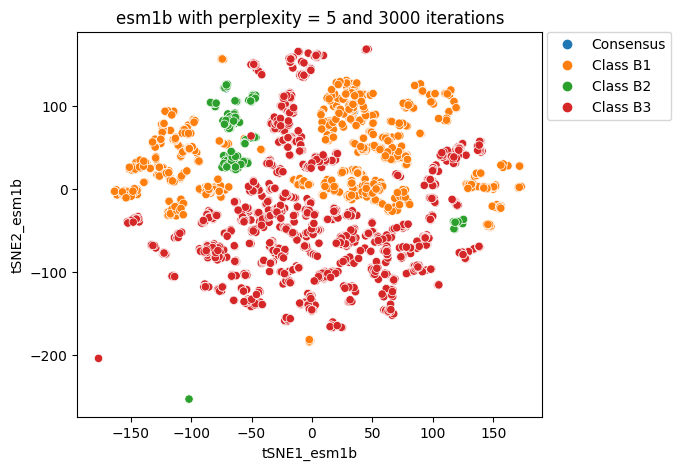

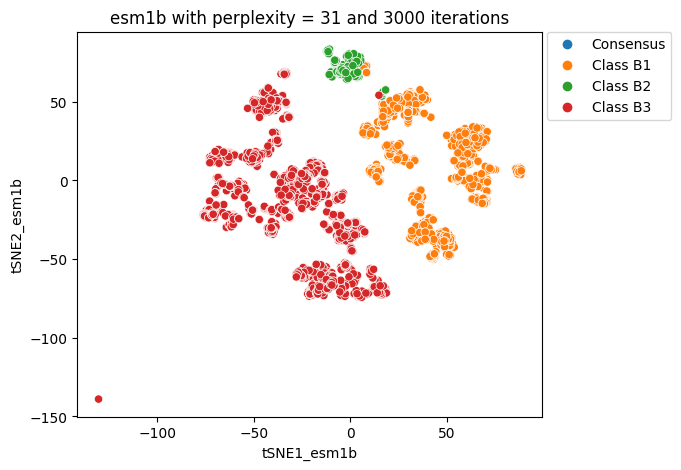

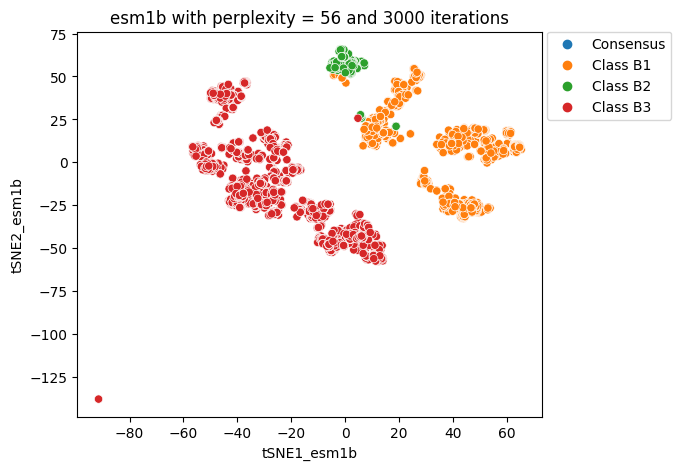

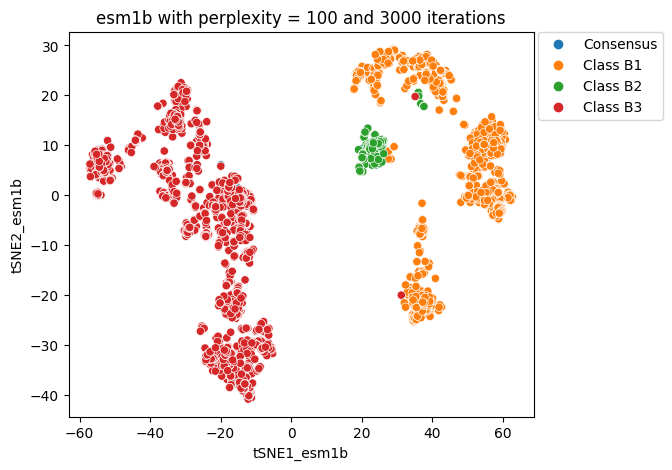

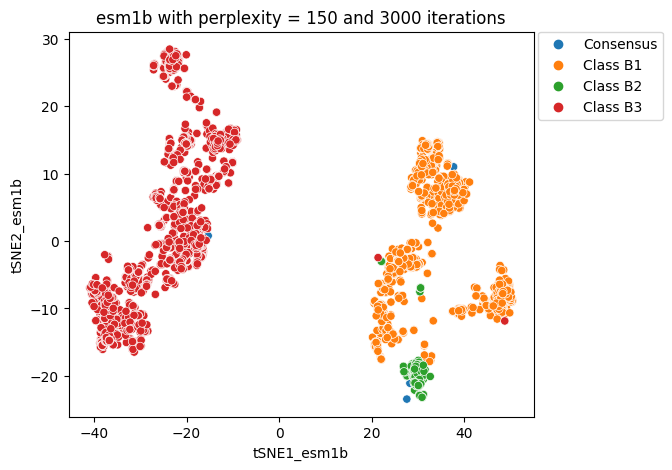

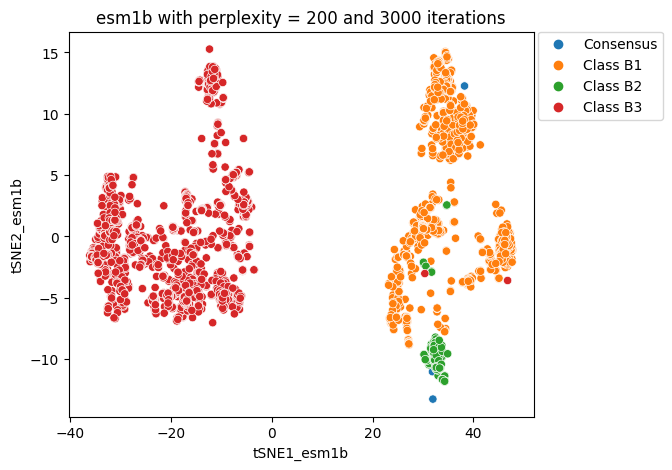

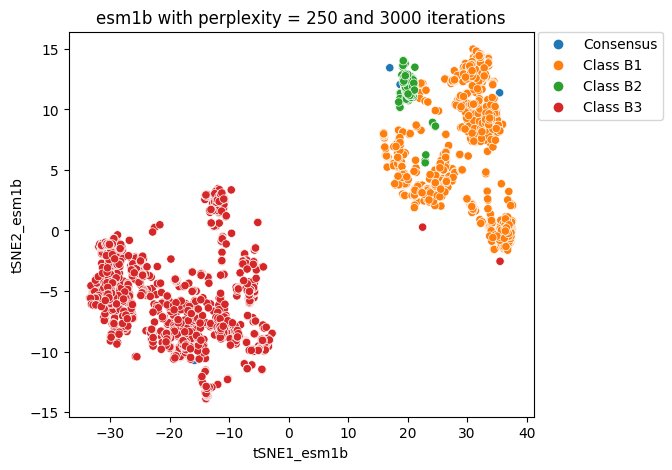

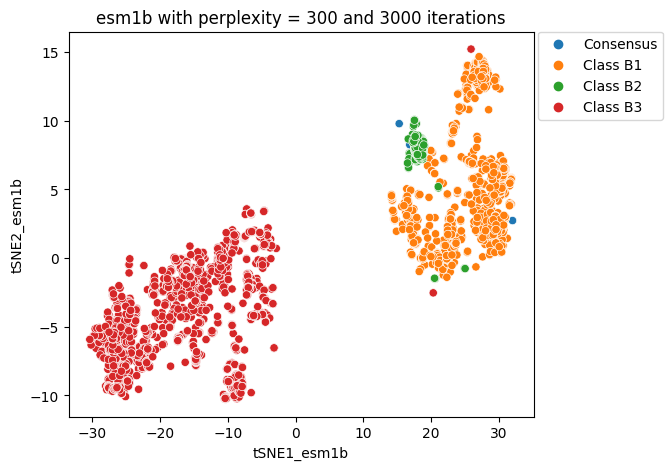

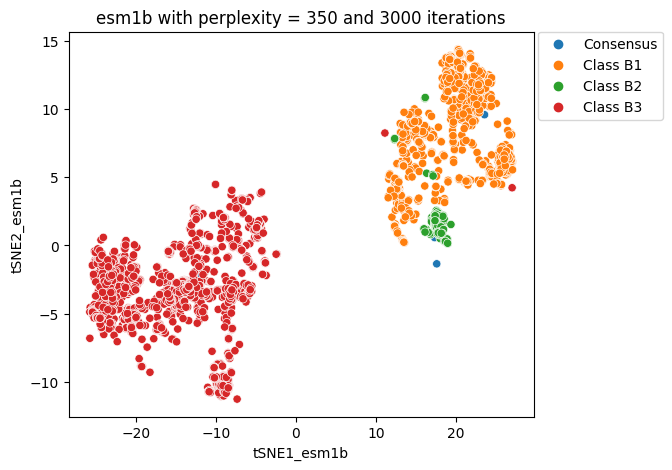

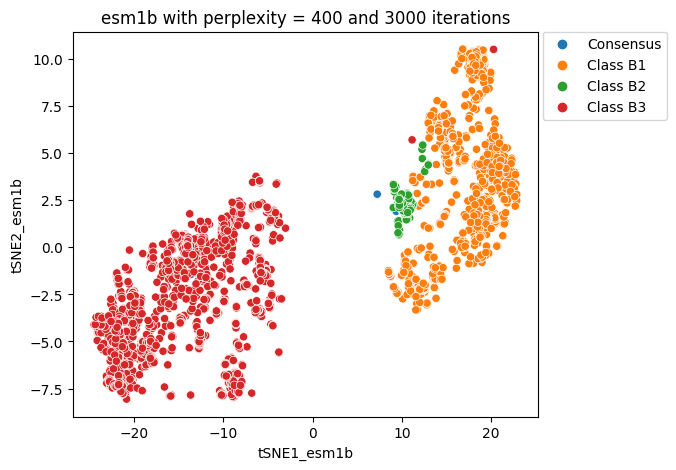

In [13]:
# sample size for mbl 3134  | 3134^(1/2) ~ 56 | 3134/100 ~ 31

# set perp vals to test
perp_lst = [5, 31, 56, 100, 150, 200, 250, 300, 350, 400]

for val  in perp_lst:
    
    tsne_options = {"n_components": 2, "perplexity": val, "n_iter": 3000, "metric": "cosine"}

    # set names
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    print(f"\n #################### starting analysis for {model} with MBLs and perplexity = {val} #################### \n")
    
    # compute tsne
    proyected_dims = tsne_reduce(df_mbl[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df_mbl[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"{model} with perplexity = {val} and 3000 iterations")
    plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0)
    
    # save data
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_perptest_mbl_" + str(val) + "_" + model + ".csv"
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

In [9]:
# take the kldiv values 

perp_mbl     = [    5,        31,         56,       100,       150,       200,       250,      300,       350,       400    ]

kl250_mbl  = [72.138123, 60.085938, 57.366306, 54.507645, 52.677197 , 51.833878 ,  50.788544, 49.569672, 48.519573, 47.650810]

kl3000_mbl = [ 0.541306,  0.454932,  0.417308,  0.371530,  0.344232,   0.321221,    0.301652,  0.274671,  0.262117,  0.255553]

# create a df
df_kl_mbl = pd.DataFrame()
df_kl_mbl["perplexity"] = perp_mbl
df_kl_mbl["initial"] = kl250_mbl
df_kl_mbl["final"] = kl3000_mbl
df_kl_mbl

,perplexity,initial,final
0,5,72.138123,0.541306
1,31,60.085938,0.454932
2,56,57.366306,0.417308
3,100,54.507645,0.371530
4,150,52.677197,0.344232
5,200,51.833878,0.321221
6,250,50.788544,0.301652
7,300,49.569672,0.274671
8,350,48.519573,0.262117
9,400,47.650810,0.255553


Text(0, 0.5, 'Value after 3000 iterations (final)')

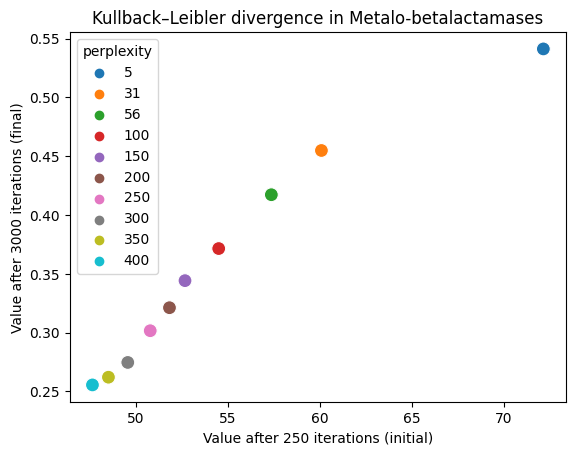

In [27]:
sns.scatterplot(data = df_kl_mbl, x='initial', y='final', hue = "perplexity", palette='tab10', s=100)
plt.title("Kullback–Leibler divergence in Metalo-betalactamases")
plt.xlabel('Value after 250 iterations (initial)')
plt.ylabel('Value after 3000 iterations (final)')

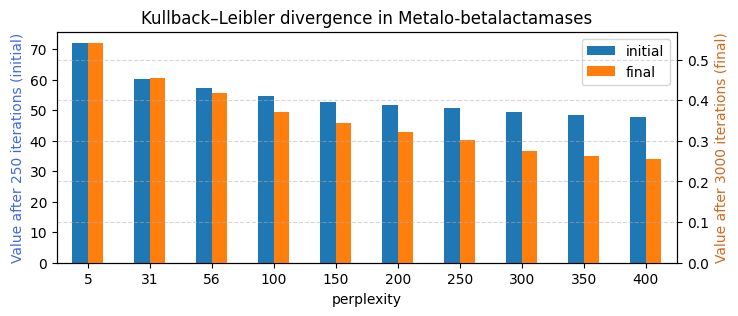

In [14]:
# barplot https://stackoverflow.com/questions/24183101/pandas-bar-plot-with-two-bars-and-two-y-axis
df_kl_mbl.plot.bar(figsize=(8,3), x = "perplexity", secondary_y= 'final',mark_right=False, rot= 0)
# gets the current figure and then the axes
ax1, ax2 = plt.gcf().get_axes() 
ax1.set_ylabel('Value after 250 iterations (initial)', color = "royalblue")
ax2.set_ylabel('Value after 3000 iterations (final)', color = "chocolate")
plt.title("Kullback–Leibler divergence in Metalo-betalactamases")
plt.grid(alpha = 0.5, linestyle = "--")

In [29]:
! ls ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl*

../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_100_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_150_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_200_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_250_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_300_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_31_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_350_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_400_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_56_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_5_esm1b.csv


In [30]:
# check data points
check = pd.read_csv("../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_mbl_400_esm1b.csv")
check = check.merge(df, on =  "seq_id")
do_iscatter(check, "tSNE1_esm1b", "tSNE2_esm1b", "bla_subclass")

The two (one) anomalies (AF2 predictions):
1. A Protease: https://www.ncbi.nlm.nih.gov/protein/AIC95013.1?report=fasta 
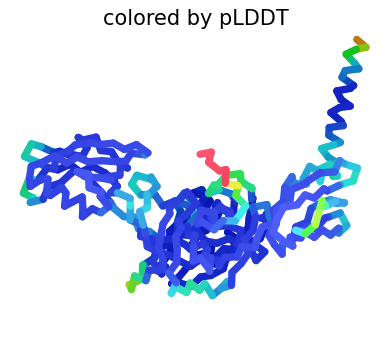
2. A partial betalactamase https://www.ncbi.nlm.nih.gov/protein/GAJ51148.1?report=fasta 
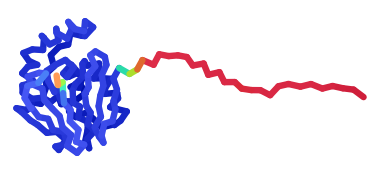

### SBL


 #################### starting analysis for esm1b with SBLs and perplexity = 5 #################### 

[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.013s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 15.194s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 12.913s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 14.548s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 14.272s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 601 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.014s...
[t-SNE] Computed neighbors for 22687 samples in 16.120s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for s

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Indexed 22687 samples in 0.013s...
[t-SNE] Computed neighbors for 22687 samples in 15.379s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed condit

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 16.726s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 16.124s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1051 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.013s...
[t-SNE] Computed neighbors for 22687 samples in 17.121s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 19.351s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

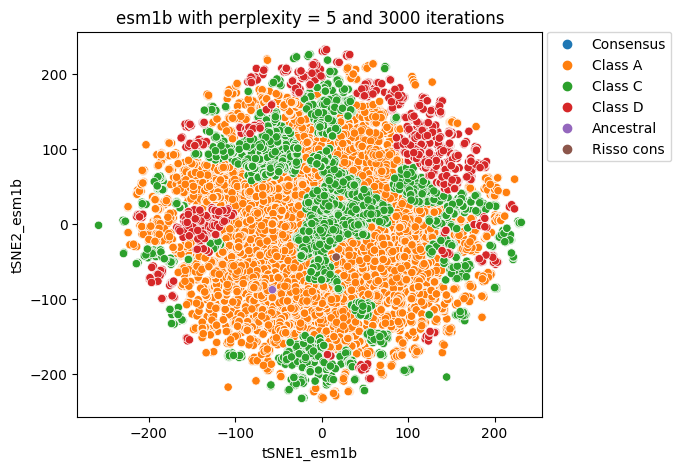

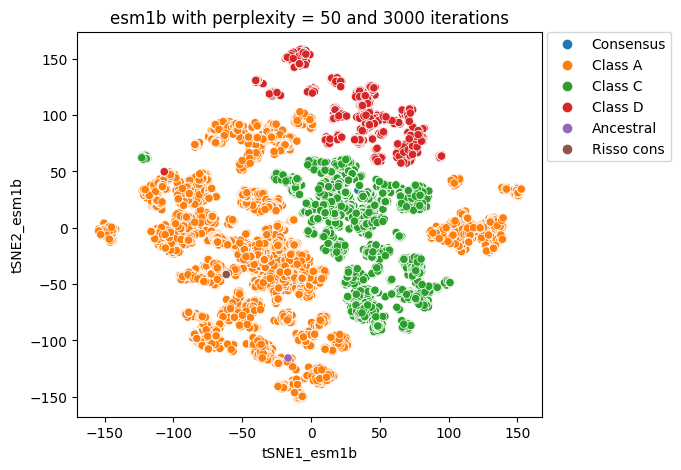

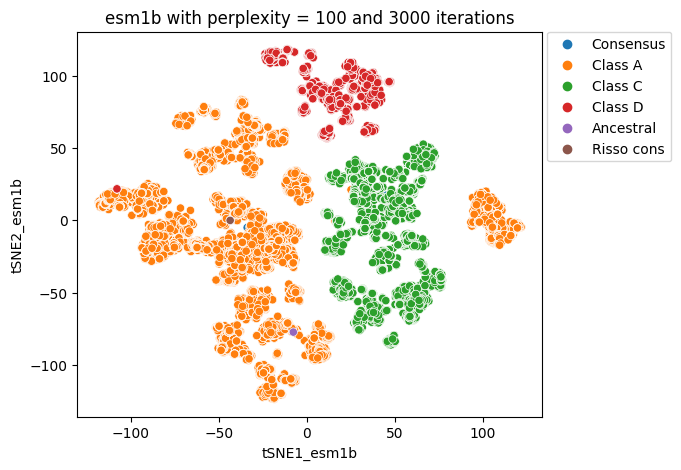

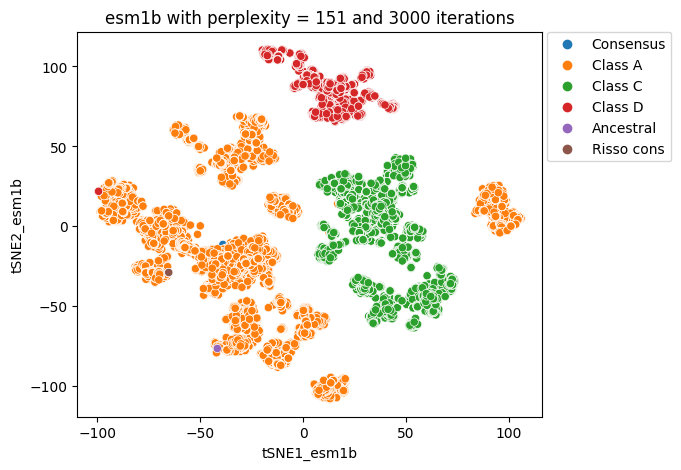

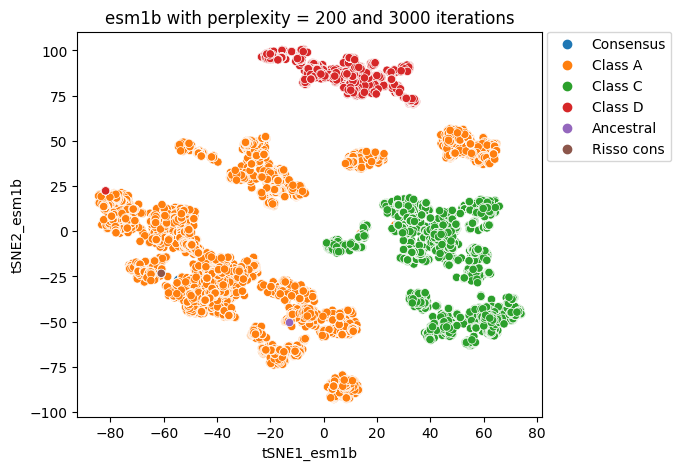

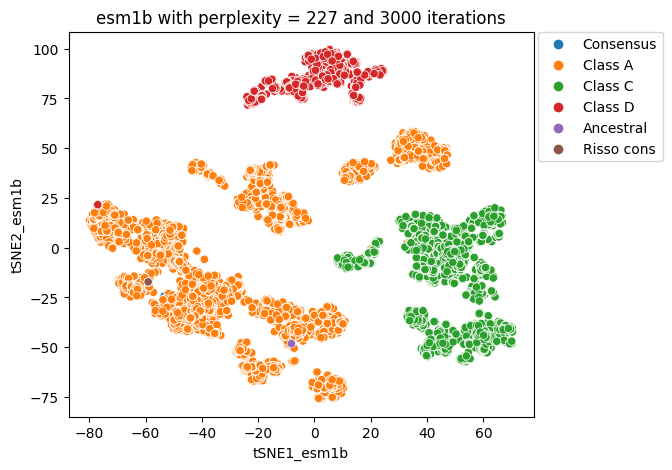

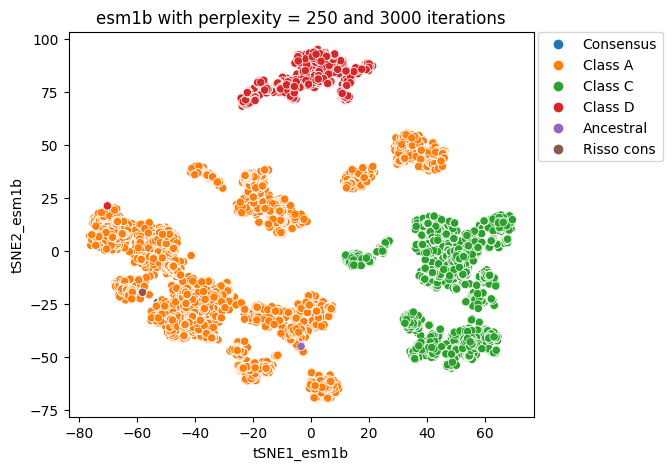

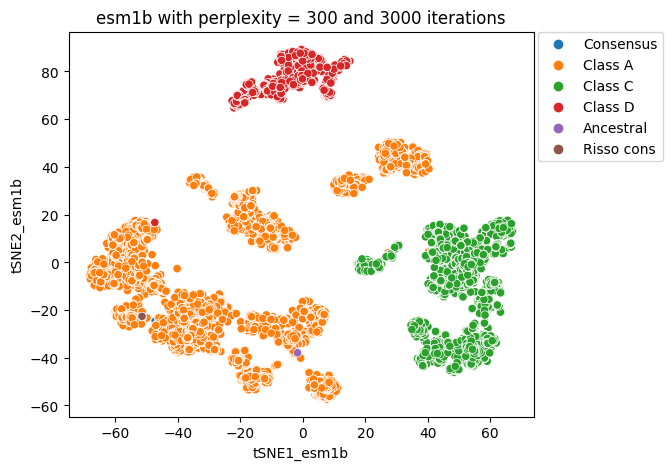

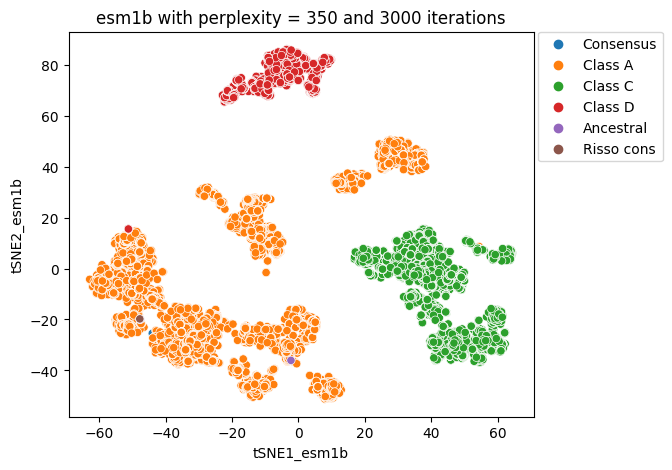

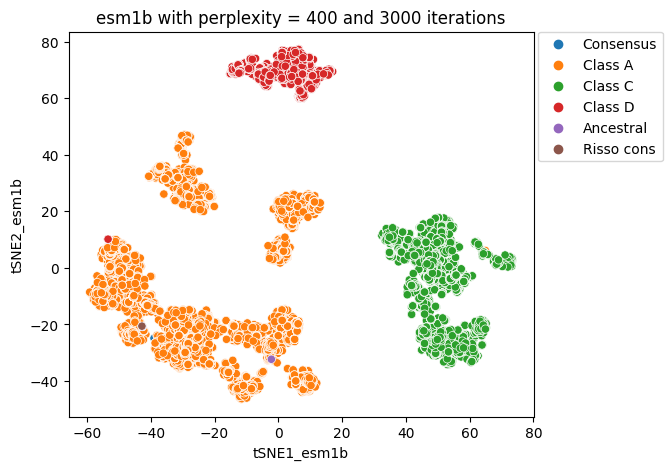

In [14]:
# sample size for sbl 22687   | 22687^(1/2) ~ 151 | 22687/100 ~ 227
# set perp vals to test
perp_lst = [5, 50, 100, 151, 200, 227, 250, 300, 350, 400]

for val  in perp_lst:
    
    tsne_options = {"n_components": 2, "perplexity": val, "n_iter": 3000, "metric": "cosine"}

    # set names
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    print(f"\n #################### starting analysis for {model} with SBLs and perplexity = {val} #################### \n")
    
    # compute tsne
    proyected_dims = tsne_reduce(df_sbl[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df_sbl[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"{model} with perplexity = {val} and 3000 iterations")
    plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0)
    
    # save data
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_perptest_sbl_" + str(val) + "_" + model + ".csv"
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

In [16]:
# take the kldiv values 

perp_sbl     = [    5,        50,        100,        151,       200,       227,       250,       300,      350,     400   ]

kl250_sbl  = [92.391296, 69.699173,  64.479836,  61.833794, 59.858765, 59.043835, 58.365276, 57.087326,  55.982796, 55.039932]

kl3000_sbl = [ 1.051599,  0.659262,   0.571308,   0.518912,  0.487051,  0.471809,  0.459293,  0.439388,   0.424166,  0.407505]

# create a df
df_kl_sbl = pd.DataFrame()
df_kl_sbl["perplexity"] = perp_sbl
df_kl_sbl["initial"] = kl250_sbl
df_kl_sbl["final"] = kl3000_sbl
df_kl_sbl

,perplexity,initial,final
0,5,92.391296,1.051599
1,50,69.699173,0.659262
2,100,64.479836,0.571308
3,151,61.833794,0.518912
4,200,59.858765,0.487051
5,227,59.043835,0.471809
6,250,58.365276,0.459293
7,300,57.087326,0.439388
8,350,55.982796,0.424166
9,400,55.039932,0.407505


Text(0, 0.5, 'Value after 3000 iterations (final)')

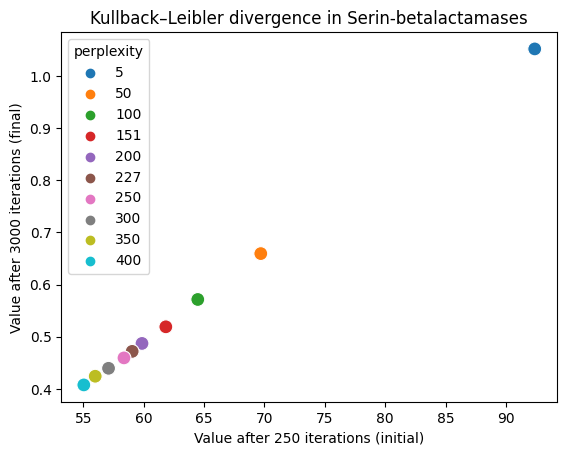

In [32]:
sns.scatterplot(data = df_kl_sbl, x='initial', y='final', hue = "perplexity", palette='tab10', s=100)
plt.title("Kullback–Leibler divergence in Serin-betalactamases")
plt.xlabel('Value after 250 iterations (initial)')
plt.ylabel('Value after 3000 iterations (final)')

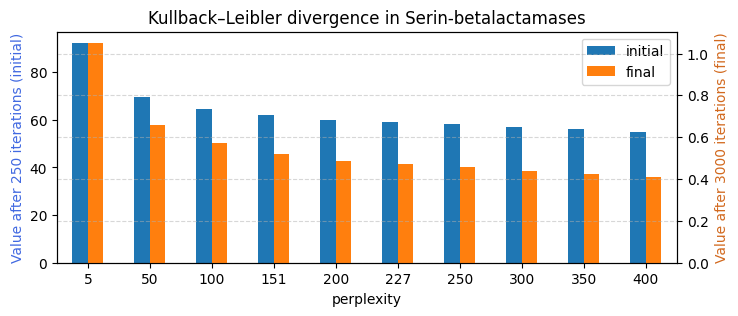

In [17]:
# plot 
df_kl_sbl.plot.bar(figsize=(8,3), x = "perplexity", secondary_y= 'final', mark_right=False, rot= 0)
# gets the current figure and then the axes
ax1, ax2 = plt.gcf().get_axes() 
ax1.set_ylabel('Value after 250 iterations (initial)', color = "royalblue")
ax2.set_ylabel('Value after 3000 iterations (final)', color = "chocolate")
plt.title("Kullback–Leibler divergence in Serin-betalactamases")
plt.grid(alpha = 0.5, linestyle = "--")

In [34]:
ls ../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl*

../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_100_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_151_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_200_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_227_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_250_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_300_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_350_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_400_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_50_esm1b.csv
../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_5_esm1b.csv


In [35]:
# tsne_2d_perptest_mbl_31_esm1b
check2 = pd.read_csv("../results/dim_redo/splitted_classes/tsne/tsne_2d_perptest_sbl_400_esm1b.csv")
check2 = check2.merge(df, on =  "seq_id")
do_iscatter(check2, "tSNE1_esm1b", "tSNE2_esm1b", "bla_subclass")

## effect of iterations 

### mbl

#################### starting analysis for esm1b with 500 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.590s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650814
[t-SNE] KL divergence after 500 iterations: 0.257738
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_500_esm1b.csv
#################### starting analysis for esm1b with 1000 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.003s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.827s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650810
[t-SNE] KL divergence after 1000 iterations: 0.255607
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_1000_esm1b.csv
#################### starting analysis for esm1b with 1500 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.003s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.588s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650814
[t-SNE] KL divergence after 1500 iterations: 0.255569
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_1500_esm1b.csv
#################### starting analysis for esm1b with 2000 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.566s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650810
[t-SNE] KL divergence after 1600 iterations: 0.255553
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_2000_esm1b.csv
#################### starting analysis for esm1b with 2500 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.576s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650814
[t-SNE] KL divergence after 1600 iterations: 0.255553
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_2500_esm1b.csv
#################### starting analysis for esm1b with 3000 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.577s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650814
[t-SNE] KL divergence after 1600 iterations: 0.255553
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_3000_esm1b.csv
#################### starting analysis for esm1b with 3500 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.606s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650810
[t-SNE] KL divergence after 1600 iterations: 0.255553
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_3500_esm1b.csv
#################### starting analysis for esm1b with 4000 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.532s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650814
[t-SNE] KL divergence after 1600 iterations: 0.255553
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_itertest_mbl_4000_esm1b.csv


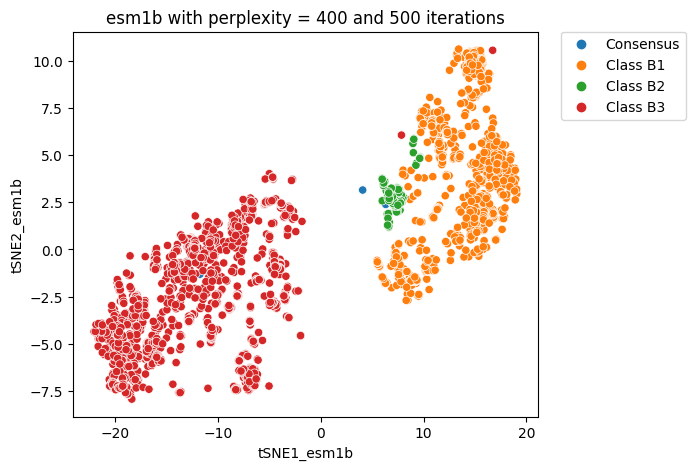

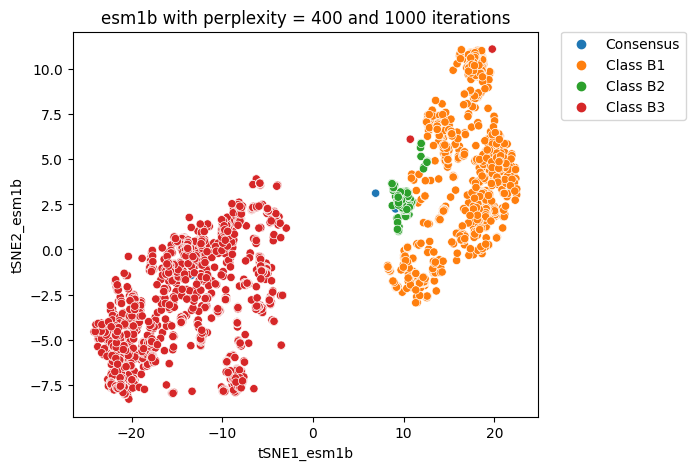

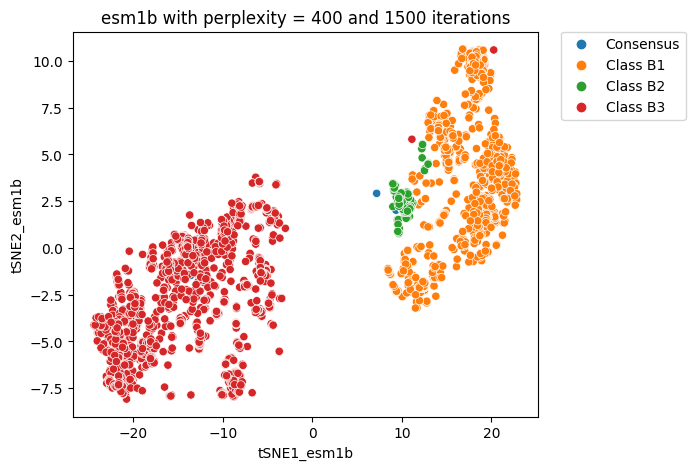

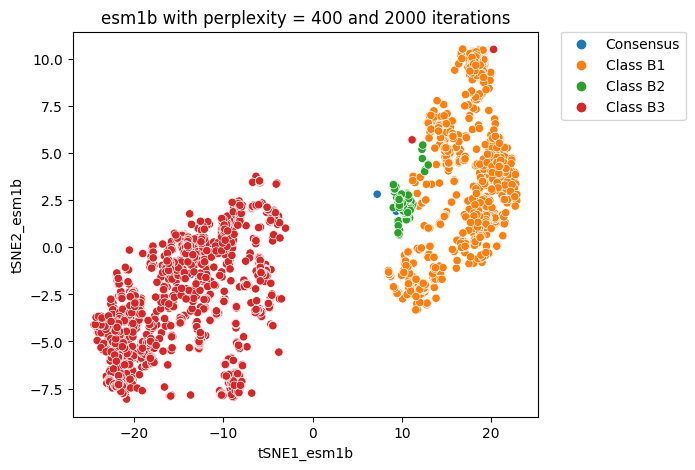

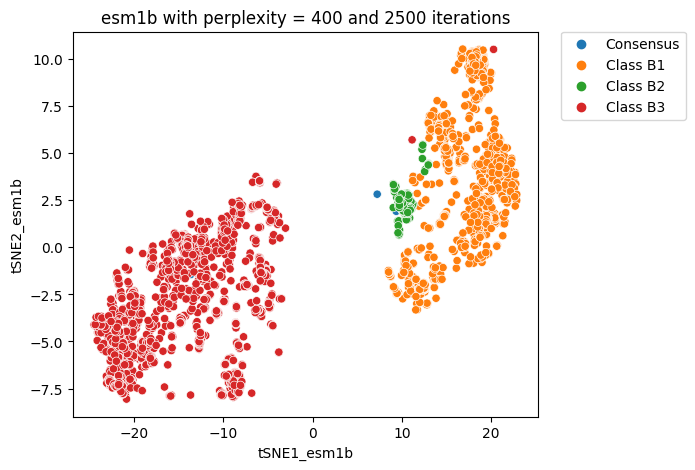

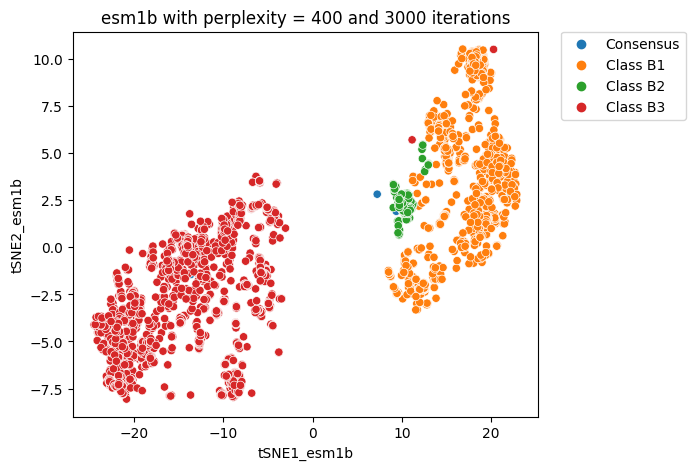

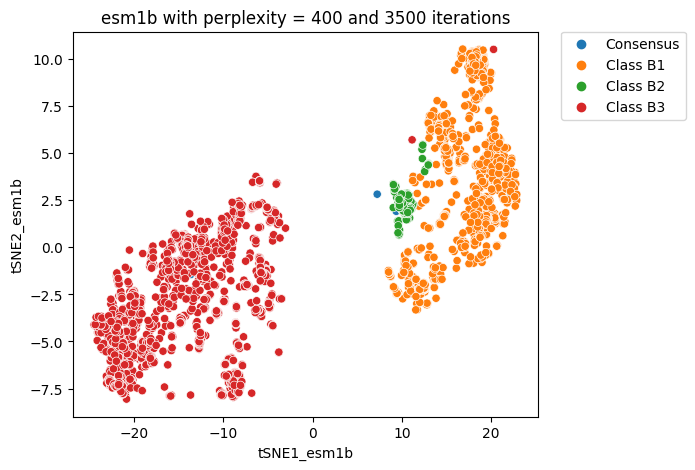

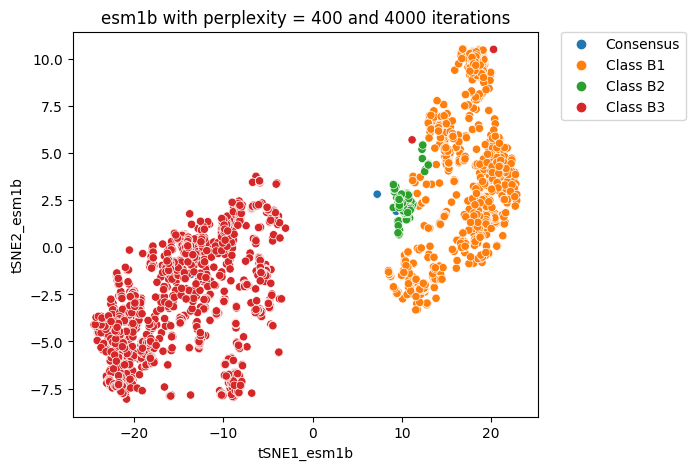

In [16]:
# by deafult, the min value is 250 iterations
iter_lst = [500, 1000, 1500, 2000, 2500, 3000, 3500, 4000]

for val  in iter_lst:
    
    tsne_options = {"n_components": 2, "perplexity": 400, "n_iter": val, "metric": "cosine"}

    # set names
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    print(f"#################### starting analysis for {model} with {val} iterations ####################")
    
    # compute tsne
    proyected_dims = tsne_reduce(df_mbl[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df_mbl[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"{model} with perplexity = 400 and {val} iterations")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)
    
    # save data
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_itertest_mbl_" + str(val) + "_" + model + ".csv"
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

In [19]:
# take the kldiv values at 258 perp
iter_lst_df   = [  500,      1000,      1500,       2000,     2500,       3000,       3500,      4000   ]
iter_250_mbl  = [ 47.650814, 47.650810, 47.650814, 47.650810, 47.650814, 47.650814, 47.650810, 47.650814]
iter_3000_mbl = [  0.257738,  0.255607,  0.255569,  0.255553,  0.255553,  0.255553,  0.255553,  0.255553]


df_iter_mbl = pd.DataFrame()
df_iter_mbl["iterations"] = iter_lst_df
df_iter_mbl["initial"] = iter_250_mbl
df_iter_mbl["final"] = iter_3000_mbl
df_iter_mbl

,iterations,initial,final
0,500,47.650814,0.257738
1,1000,47.650810,0.255607
2,1500,47.650814,0.255569
3,2000,47.650810,0.255553
4,2500,47.650814,0.255553
5,3000,47.650814,0.255553
6,3500,47.650810,0.255553
7,4000,47.650814,0.255553


(0.2, 0.3)

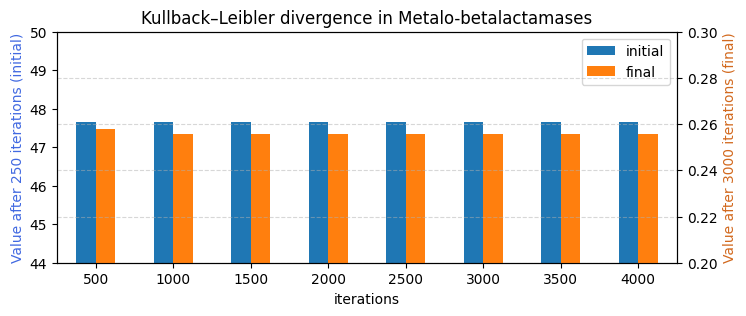

In [20]:
# plot 
df_iter_mbl.plot.bar(figsize=(8,3), x = "iterations", secondary_y= 'final', mark_right=False, rot= 0)
# gets the current figure and then the axes
ax1, ax2 = plt.gcf().get_axes() 
ax1.set_ylabel('Value after 250 iterations (initial)', color = "royalblue")
ax2.set_ylabel('Value after 3000 iterations (final)', color = "chocolate")
plt.title("Kullback–Leibler divergence in Metalo-betalactamases")
plt.grid(alpha = 0.5, linestyle = "--")
ax1.set_ylim([44,50])
ax2.set_ylim([0.20, 0.3])

### sbl

#################### starting analysis for esm1b with 500 iterations ####################
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.013s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 18.532s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 16.616s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 16.256s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.014s...
[t-SNE] Computed neighbors for 22687 samples in 17.302s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.014s...
[t-SNE] Computed neighbors for 22687 samples in 18.774s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.013s...
[t-SNE] Computed neighbors for 22687 samples in 17.310s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 17.018s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 16.862s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

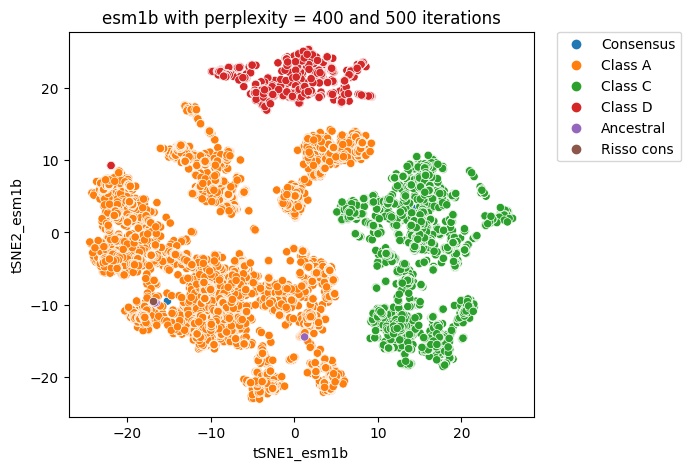

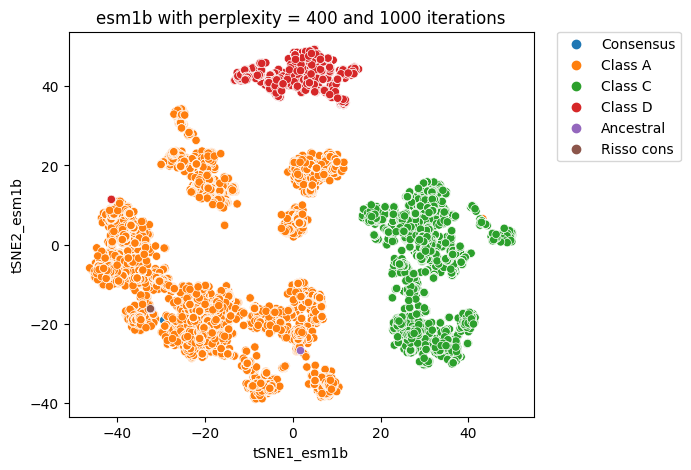

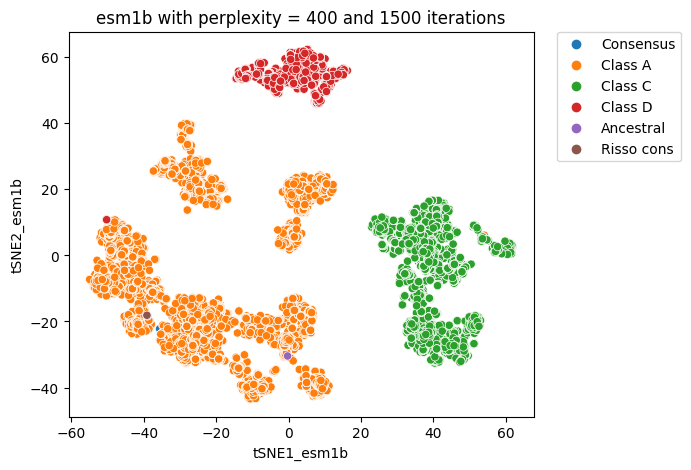

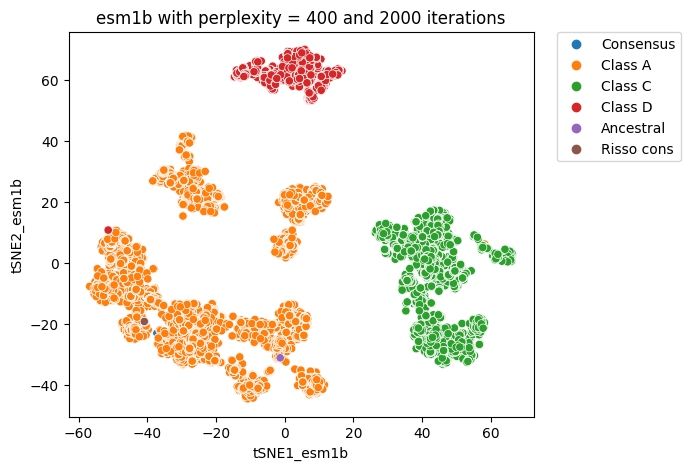

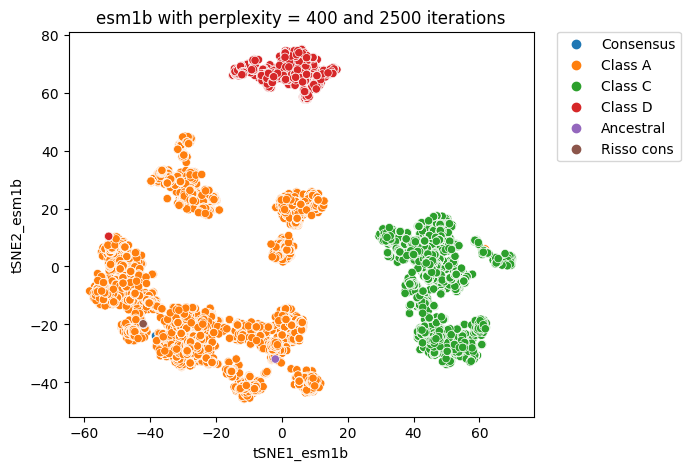

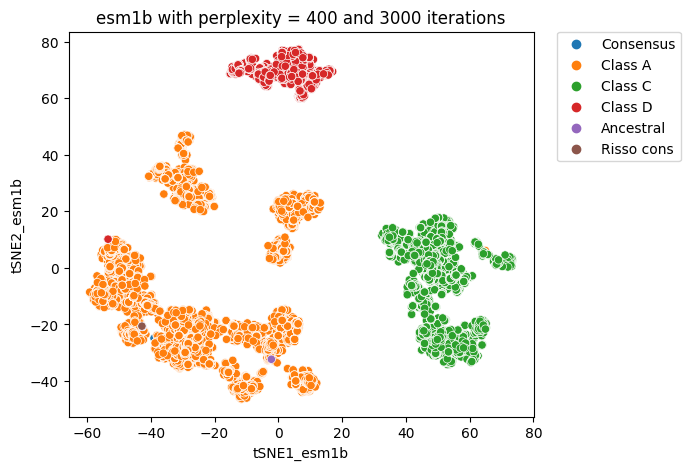

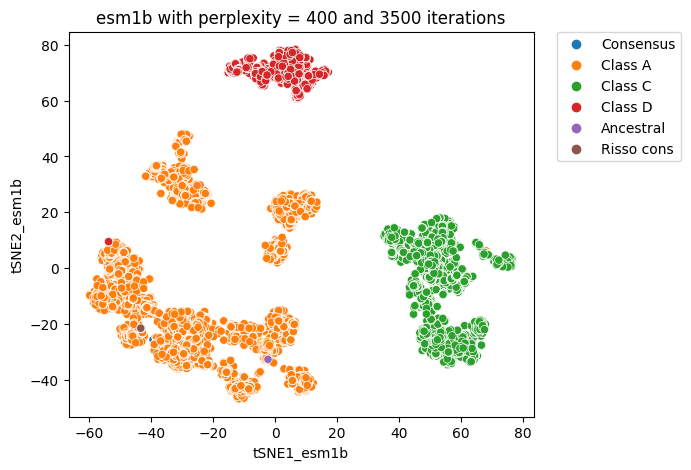

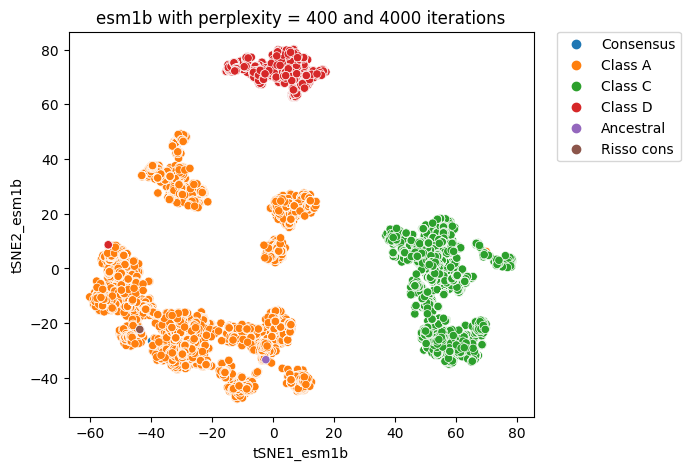

In [17]:
iter_lst = [500, 1000, 1500, 2000, 2500, 3000, 3500, 4000]

for val  in iter_lst:
    
    tsne_options = {"n_components": 2, "perplexity": 400, "n_iter": val, "metric": "cosine"}

    # set names
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    print(f"#################### starting analysis for {model} with {val} iterations ####################")
    
    # compute tsne
    proyected_dims = tsne_reduce(df_sbl[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df_sbl[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"{model} with perplexity = 400 and {val} iterations")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)
    
    # save data
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_itertest_sbl_" + str(val) + "_" + model + ".csv"
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

In [21]:
# take the kldiv values at 258 perp
# iter_lst_df = [       500,      1000,      1500,       2000,     2500,       3000,     3500,      4000,   ]
iter_250_sbl      = [55.039932, 55.039932, 55.039932, 55.039932,  55.039932, 55.039932, 55.039932, 55.039932]
iter_3000_sbl     = [ 0.615214,  0.444467,  0.420549,  0.414310,   0.410041,  0.407505,  0.405800,  0.404258]


df_iter_sbl = pd.DataFrame()
df_iter_sbl["iterations"] = iter_lst_df
df_iter_sbl["initial"] = iter_250_sbl
df_iter_sbl["final"] = iter_3000_sbl
df_iter_sbl

,iterations,initial,final
0,500,55.039932,0.615214
1,1000,55.039932,0.444467
2,1500,55.039932,0.420549
3,2000,55.039932,0.414310
4,2500,55.039932,0.410041
5,3000,55.039932,0.407505
6,3500,55.039932,0.405800
7,4000,55.039932,0.404258


(0.0, 0.7)

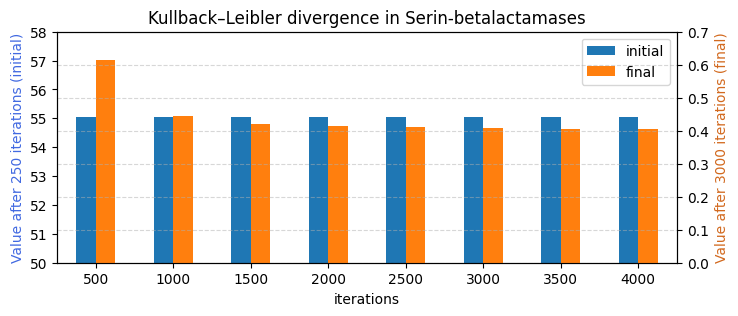

In [22]:
# plot 
df_iter_sbl.plot.bar(figsize=(8,3), x = "iterations", secondary_y= 'final', mark_right=False, rot= 0)
# gets the current figure and then the axes
ax1, ax2 = plt.gcf().get_axes() 
ax1.set_ylabel('Value after 250 iterations (initial)', color = "royalblue")
ax2.set_ylabel('Value after 3000 iterations (final)', color = "chocolate")
plt.title("Kullback–Leibler divergence in Serin-betalactamases")
plt.grid(alpha = 0.5, linestyle = "--")
ax1.set_ylim([50,58])
ax2.set_ylim([0.0, 0.7])

## tsne per bla class 

In [18]:
def do_perclass_tsne(bla_class):
    
    """
    compute a tsne given a bla class
    """

    # set class and optimal perp
    df_class = df[df.bla_class.str.contains(bla_class)]
    #len_class = len(df_class)
    #opt_perp = np.round(len_class/100)
    
    # names 
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    print(f" \n #################### starting analysis for {bla_class} with {model} #################### \n")

    # tsne 
    tsne_options = {"n_components": 2, "perplexity": 400, "n_iter": 1500, "metric": "cosine"}
    proyected_dims = tsne_reduce(df_class[model].to_list(), **tsne_options)
    
    # add annot 
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df_class[["seq_id", "protein_family_header"]].set_index(tsne.index)], axis=1)
    
    # filter annot and rename col items 
    top19_fams = pd.value_counts(tsne["protein_family_header"]).head(19).index
    tsne.loc[~tsne["protein_family_header"].isin(top19_fams), "protein_family_header"] = 'No top 20'
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "protein_family_header", palette="tab20")
    plt.title(f"{bla_class} with {model}")
    plt.legend(bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0, ncols=2)
    
    #save
    path = "../results/dim_redo/splitted_classes/tsne/tsne_2d_perclass_" + bla_class.replace(" ","_") + "_" + model + ".csv"
    tsne.to_csv(path, index = False)
    print(f" file saved at {path}")

 
 #################### starting analysis for Class A with esm1b #################### 

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 13314 samples in 0.008s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 13314 samples in 6.440s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13314
[t-SNE] Computed conditional probabilities for sample 2000 / 13314
[t-SNE] Computed conditional probabilities for sample 3000 / 13314
[t-SNE] Computed conditional probabilities for sample 4000 / 13314
[t-SNE] Computed conditional probabilities for sample 5000 / 13314
[t-SNE] Computed conditional probabilities for sample 6000 / 13314
[t-SNE] Computed conditional probabilities for sample 7000 / 13314
[t-SNE] Computed conditional probabilities for sample 8000 / 13314
[t-SNE] Computed conditional probabilities for sample 9000 / 13314
[t-SNE] Computed conditional probabilities for sample 10000 / 13314
[t-SNE] Computed conditional probabilities for sample 11000 / 13314
[t-SNE] Computed conditional probabilities for sample 12000 / 13314
[t-SNE] Computed conditional probabilities for sample 13000 / 13314
[t-SNE] Computed conditional probabilities for sample 13314 / 13314

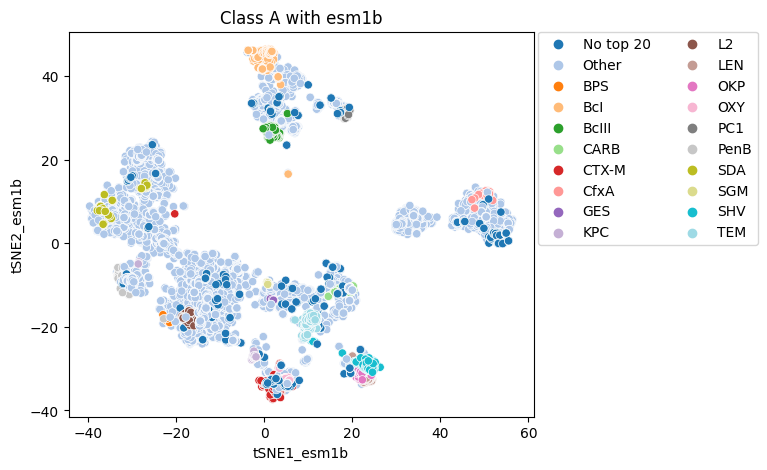

In [19]:
do_perclass_tsne("Class A")

 
 #################### starting analysis for Class B with esm1b #################### 

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3130 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3130 samples in 0.692s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3130
[t-SNE] Computed conditional probabilities for sample 2000 / 3130
[t-SNE] Computed conditional probabilities for sample 3000 / 3130
[t-SNE] Computed conditional probabilities for sample 3130 / 3130
[t-SNE] Mean sigma: 0.032723
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.612247
[t-SNE] KL divergence after 1500 iterations: 0.247923
 file saved at ../results/dim_redo/splitted_classes/tsne/tsne_2d_perclass_Class_B_esm1b.csv


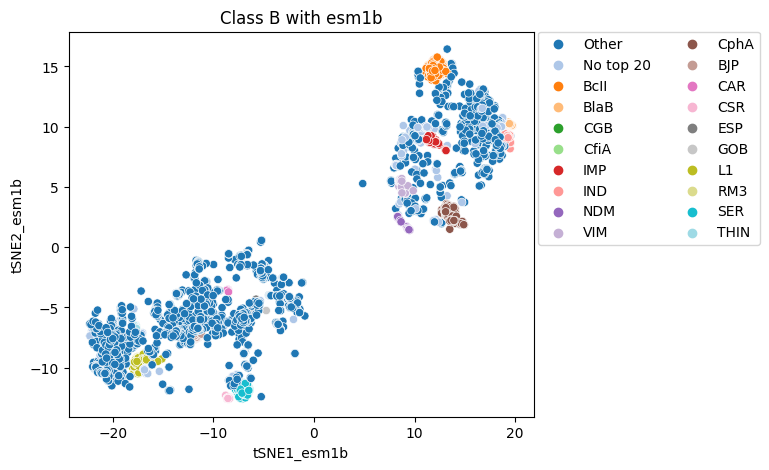

In [20]:
do_perclass_tsne("Class B")

 
 #################### starting analysis for Class C with esm1b #################### 

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 6586 samples in 0.004s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 6586 samples in 1.846s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6586
[t-SNE] Computed conditional probabilities for sample 2000 / 6586
[t-SNE] Computed conditional probabilities for sample 3000 / 6586
[t-SNE] Computed conditional probabilities for sample 4000 / 6586
[t-SNE] Computed conditional probabilities for sample 5000 / 6586
[t-SNE] Computed conditional probabilities for sample 6000 / 6586
[t-SNE] Computed conditional probabilities for sample 6586 / 6586
[t-SNE] Mean sigma: 0.005989
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.099476
[t-SNE] KL divergence after 1500 iterations: 0.364555
 file saved at ../results/dim_redo/splitted_classes/tsne/tsne_2d_perclass_Class_C_esm1b.csv


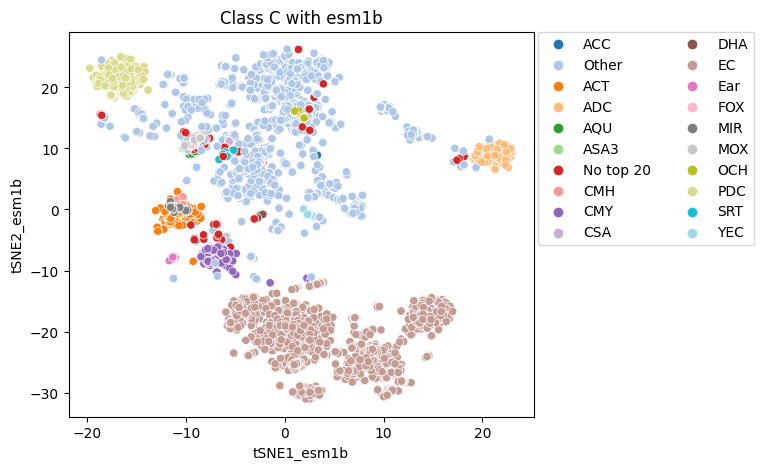

In [21]:
do_perclass_tsne("Class C")

 
 #################### starting analysis for Class D with esm1b #################### 

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 2779 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 2779 samples in 0.512s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2779
[t-SNE] Computed conditional probabilities for sample 2000 / 2779
[t-SNE] Computed conditional probabilities for sample 2779 / 2779
[t-SNE] Mean sigma: 0.024126
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.856880
[t-SNE] KL divergence after 1500 iterations: 0.226904
 file saved at ../results/dim_redo/splitted_classes/tsne/tsne_2d_perclass_Class_D_esm1b.csv


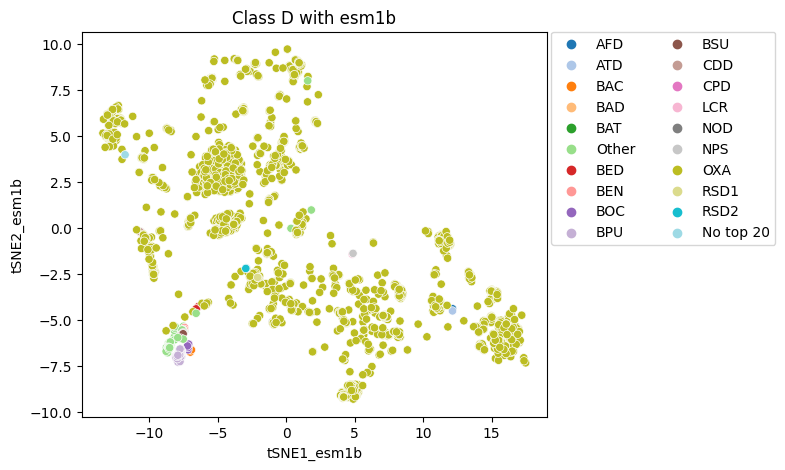

In [22]:
do_perclass_tsne("Class D")

## all plms

In [23]:
# opt perp = 25821/100 = ~258
tsne_options = {"n_components": 2, "perplexity": 400, "n_iter": 1500, "metric": "cosine"}

def do_tsne_perplm(model, df_in, bla_class):
    
    """
    A quick function to do a tSNE given a protein language model and dataset
    """
    
    # log
    print(f"\n#################### starting analysis for {model} ####################\n")
    
    # set names
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_plm_" + bla_class + "_" + model + ".csv"
    
    # compute tsne
    df = df_in
    proyected_dims = tsne_reduce(df[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"{model}")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)
    
    # save data
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

### mbl


#################### starting analysis for esm1b ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.552s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.032717
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.650814
[t-SNE] KL divergence after 1500 iterations: 0.255569
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_esm1b.csv

#################### starting analysis for esm ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.549s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.065826
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.441189
[t-SNE] KL divergence after 1500 iterations: 0.261660
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_esm.csv

#################### starting analysis for aa_composition ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.000s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.457s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.097504
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.925636
[t-SNE] KL divergence after 1050 iterations: 0.452131
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_aa_composition.csv

#################### starting analysis for t5xlu50 ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.545s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.178060
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.511421
[t-SNE] KL divergence after 1500 iterations: 0.252563
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_t5xlu50.csv

#################### starting analysis for t5bfd ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.543s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.185439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.338417
[t-SNE] KL divergence after 1200 iterations: 0.264182
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_t5bfd.csv

#################### starting analysis for xlnet ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.550s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.038354
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.477093
[t-SNE] KL divergence after 1500 iterations: 0.361393
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_xlnet.csv

#################### starting analysis for bepler ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.000s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.442s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.030607
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.937725
[t-SNE] KL divergence after 1500 iterations: 0.408869
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_bepler.csv

#################### starting analysis for carp640M ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3134 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 3134 samples in 0.550s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3134
[t-SNE] Computed conditional probabilities for sample 2000 / 3134
[t-SNE] Computed conditional probabilities for sample 3000 / 3134
[t-SNE] Computed conditional probabilities for sample 3134 / 3134
[t-SNE] Mean sigma: 0.020198
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.366936
[t-SNE] KL divergence after 1150 iterations: 0.266015
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_plm_mbl_carp640M.csv


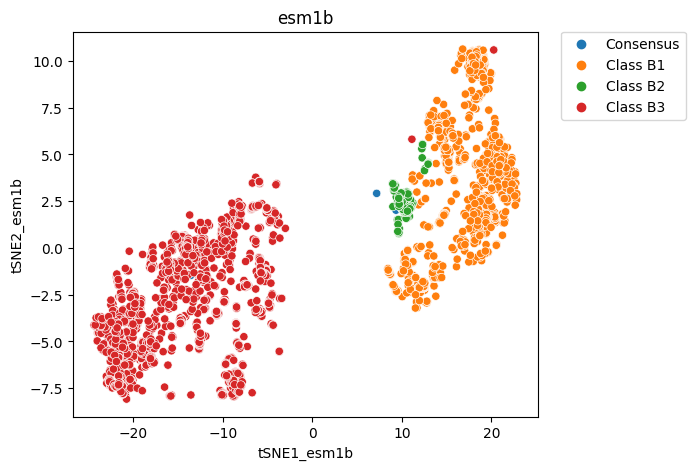

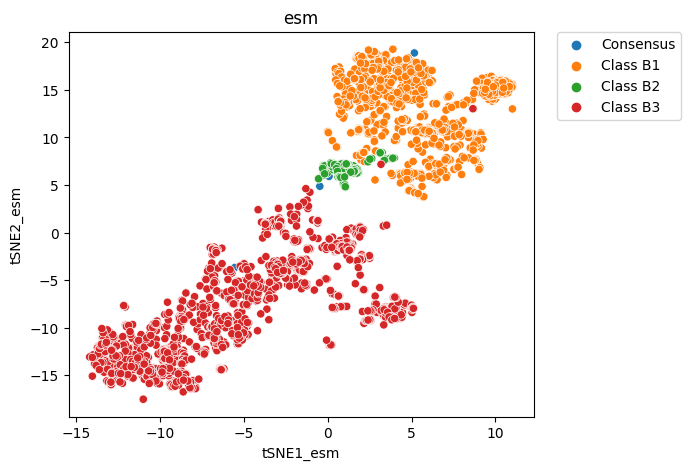

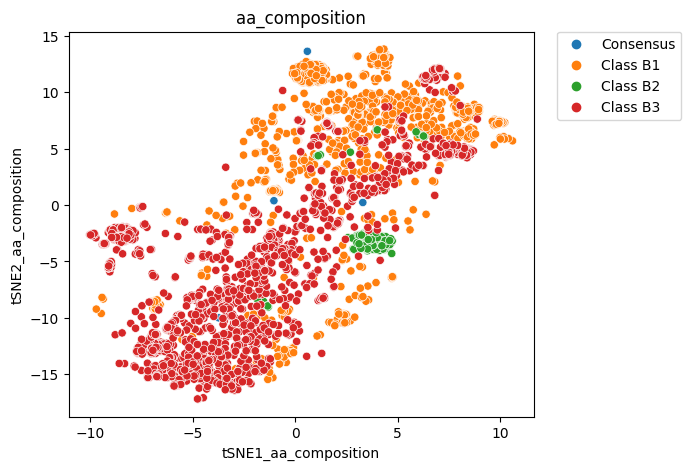

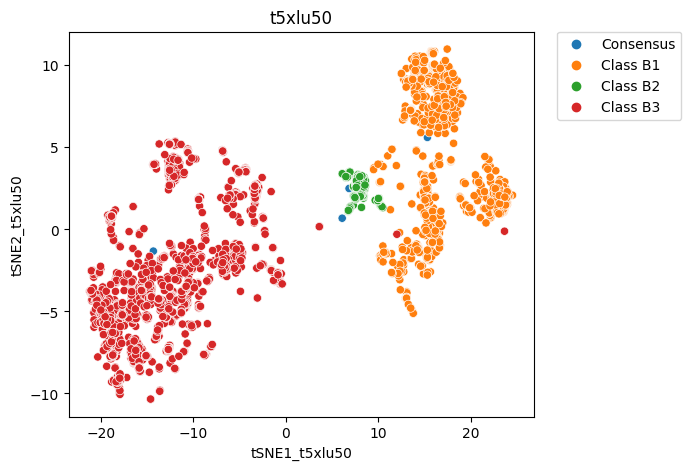

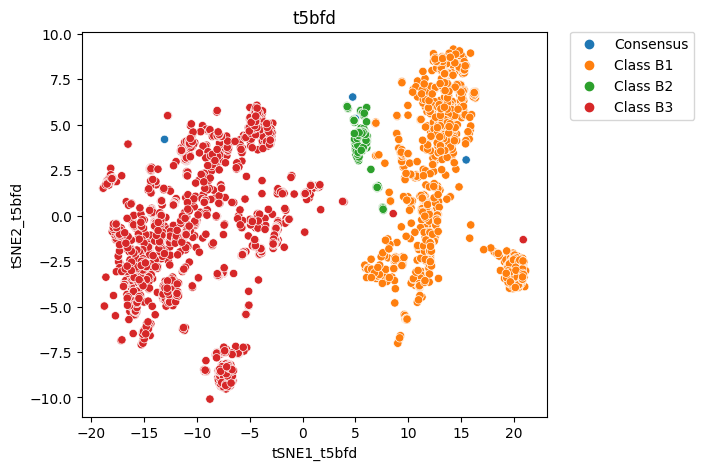

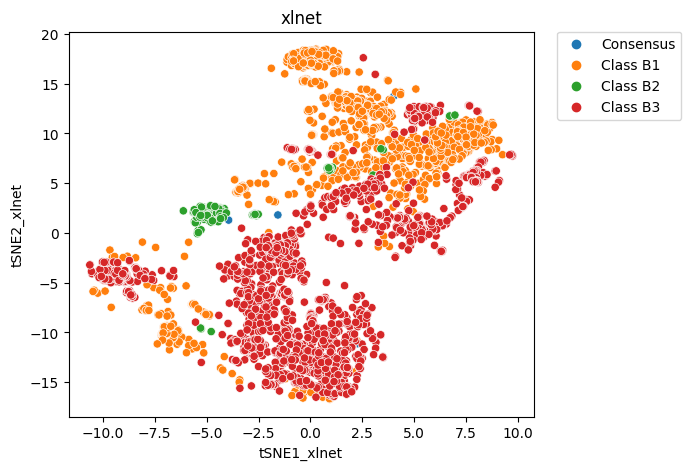

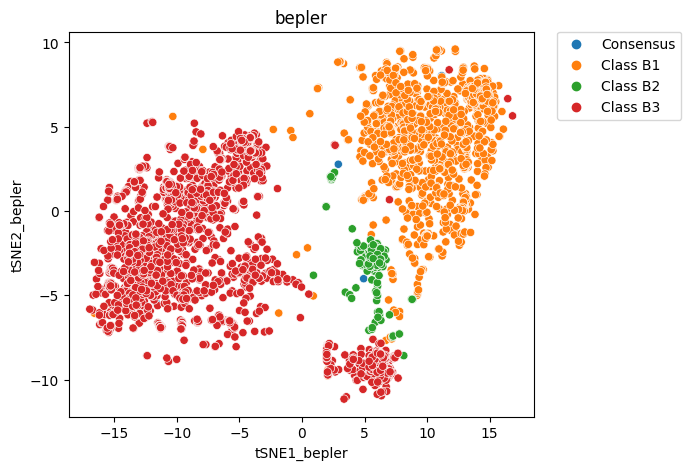

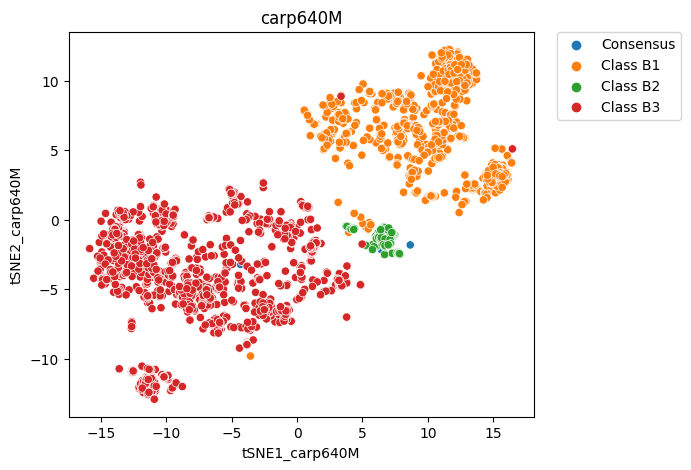

In [24]:
for model in models:
    do_tsne_perplm(model, df_mbl, "mbl")

In [24]:
# models          = ['esm1b',      'esm'  'aa_composition', 't5xlu50', 't5bfd',   'xlnet',  'bepler', 'carp640M']
kldiv_250_mbl_plm = [47.650814, 49.441189,  50.925636,      48.511421, 50.338417, 50.477093, 50.937725, 50.366936]
kldiv_3000_mbl_pl = [0.255569,   0.261660,   0.452131,       0.252563,  0.264182,  0.361393,  0.408869,  0.266015]

df_plm_mbl = pd.DataFrame()
df_plm_mbl["model"] = models
df_plm_mbl["initial"] = kldiv_250_mbl_plm
df_plm_mbl["final"] = kldiv_3000_mbl_pl
df_plm_mbl = df_plm_mbl.sort_values("final")
df_plm_mbl

,model,initial,final
3,t5xlu50,48.511421,0.252563
0,esm1b,47.650814,0.255569
1,esm,49.441189,0.261660
4,t5bfd,50.338417,0.264182
7,carp640M,50.366936,0.266015
5,xlnet,50.477093,0.361393
6,bepler,50.937725,0.408869
2,aa_composition,50.925636,0.452131


(0.0, 0.6)

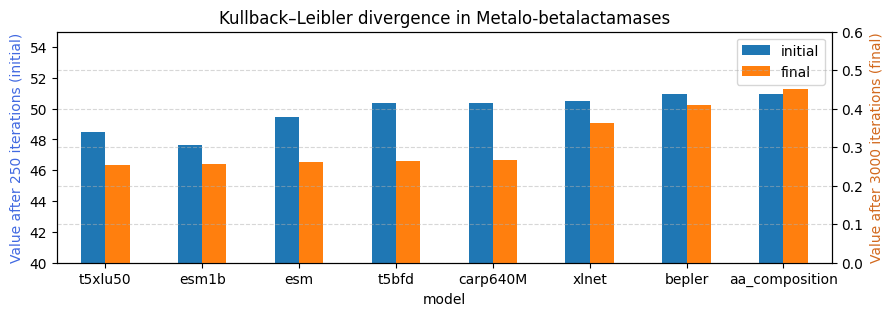

In [25]:
# plot 
df_plm_mbl.plot.bar(figsize=(10,3), x = "model", secondary_y= 'final', mark_right=False, rot= 0)
# gets the current figure and then the axes
ax1, ax2 = plt.gcf().get_axes() 
ax1.set_ylabel('Value after 250 iterations (initial)', color = "royalblue")
ax2.set_ylabel('Value after 3000 iterations (final)', color = "chocolate")
plt.title("Kullback–Leibler divergence in Metalo-betalactamases")
plt.grid(alpha = 0.5, linestyle = "--")
ax1.set_ylim([40, 55])
ax2.set_ylim([0.0, 0.6])

### sbl


#################### starting analysis for esm1b ####################

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.013s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 16.389s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.013s...
[t-SNE] Computed neighbors for 22687 samples in 16.639s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 13.090s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.010s...
[t-SNE] Computed neighbors for 22687 samples in 16.238s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.011s...
[t-SNE] Computed neighbors for 22687 samples in 16.428s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.011s...
[t-SNE] Computed neighbors for 22687 samples in 16.301s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computed neighbors for 22687 samples in 12.866s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for sample 13000 / 22687
[t-SNE] Computed conditional probabilities for sample 14000 / 2268

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning: 'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.
  warnings.warn(


[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22687 samples in 0.015s...
[t-SNE] Computed neighbors for 22687 samples in 17.930s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22687
[t-SNE] Computed conditional probabilities for sample 2000 / 22687
[t-SNE] Computed conditional probabilities for sample 3000 / 22687
[t-SNE] Computed conditional probabilities for sample 4000 / 22687
[t-SNE] Computed conditional probabilities for sample 5000 / 22687
[t-SNE] Computed conditional probabilities for sample 6000 / 22687
[t-SNE] Computed conditional probabilities for sample 7000 / 22687
[t-SNE] Computed conditional probabilities for sample 8000 / 22687
[t-SNE] Computed conditional probabilities for sample 9000 / 22687
[t-SNE] Computed conditional probabilities for sample 10000 / 22687
[t-SNE] Computed conditional probabilities for sample 11000 / 22687
[t-SNE] Computed conditional probabilities for sample 12000 / 22687
[t-SNE] Computed conditional probabilities for 

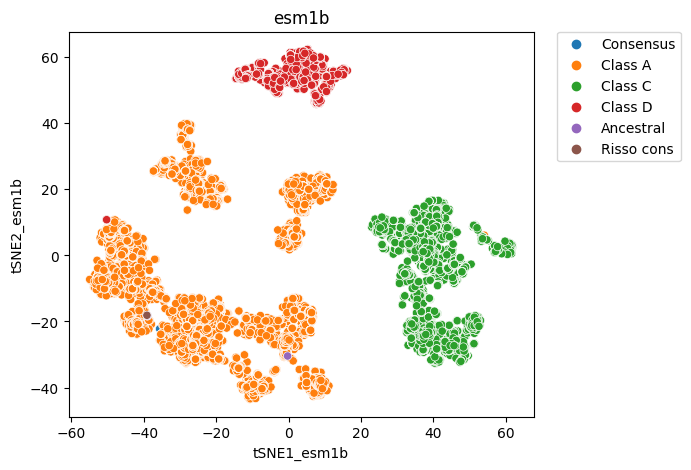

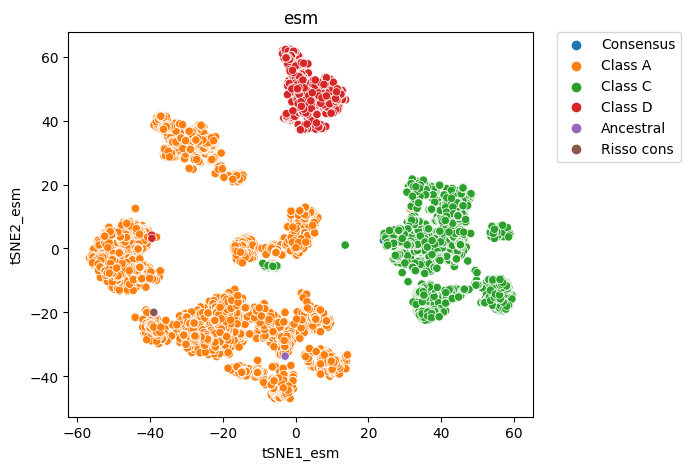

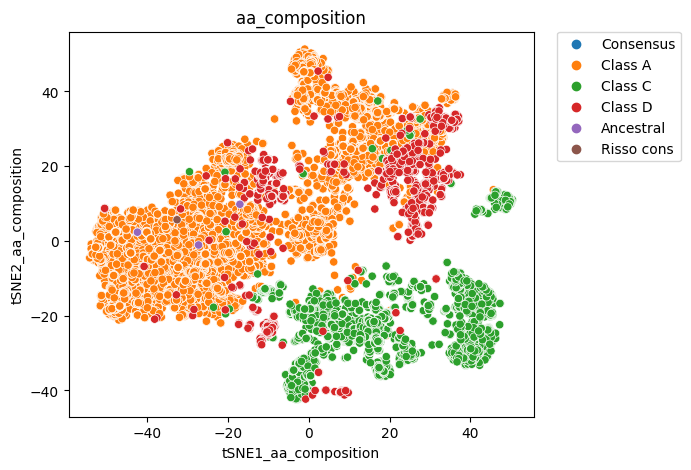

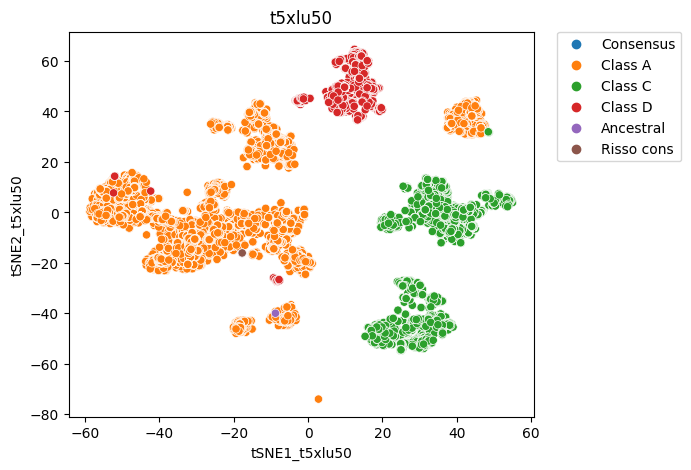

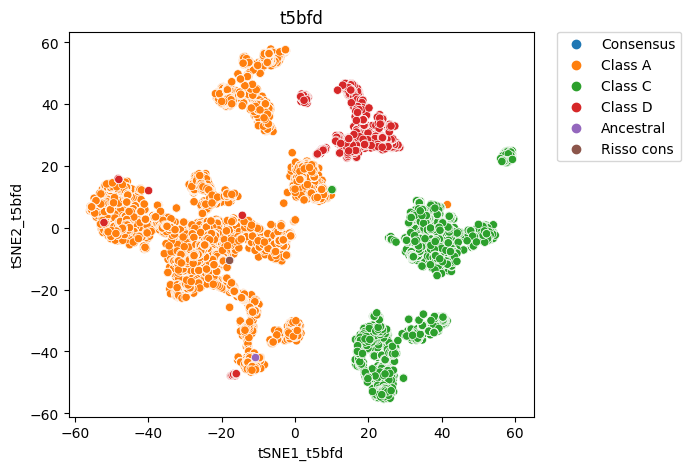

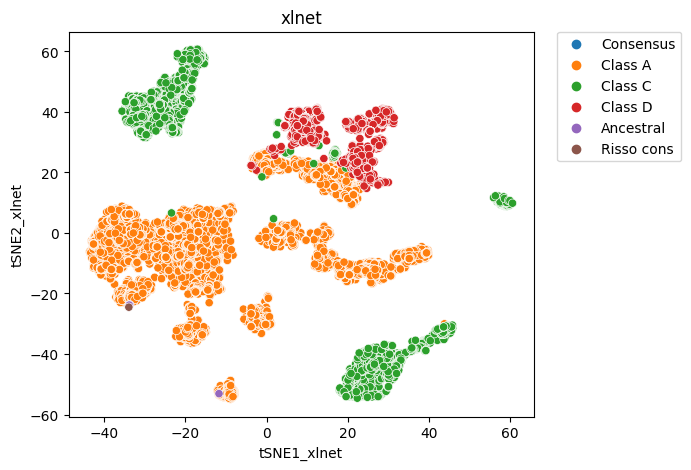

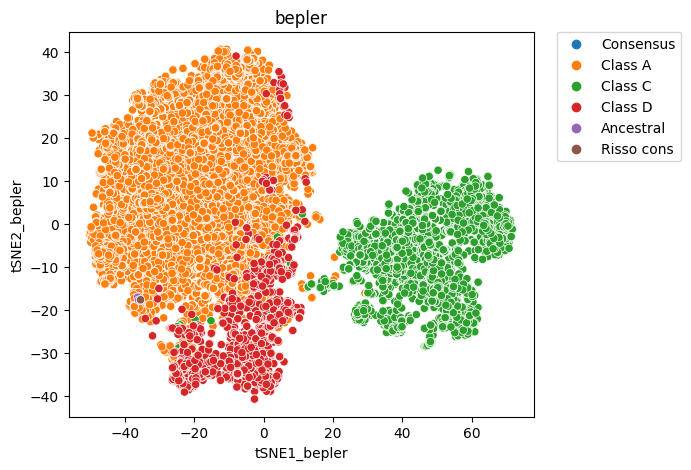

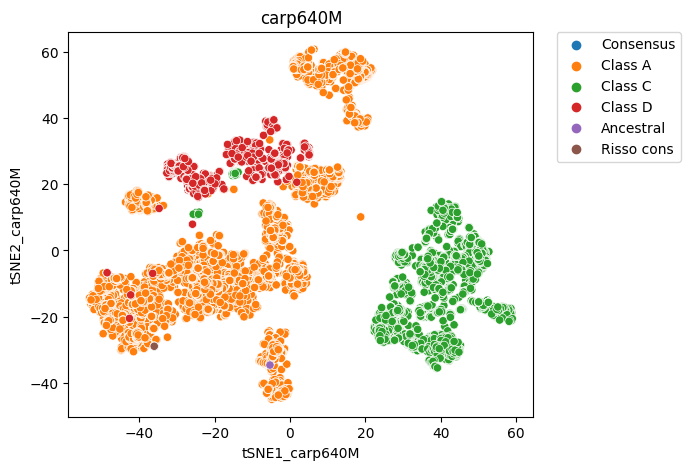

In [25]:
for model in models:
    do_tsne_perplm(model, df_sbl, "sbl")

In [27]:
# models          = ['esm1b',      'esm',    'aa_comp', 't5xlu50', 't5bfd',   'xlnet',  'bepler', 'carp640M']
kldiv_250_sbl_plm = [55.039928, 55.698082, 65.193100, 55.212772, 55.792168, 55.856621, 67.235390, 57.866863]
kldiv_300_sbl_plm = [0.420549, 0.444288, 0.776888,   0.421328, 0.441190, 0.480814,  0.961716 , 0.496819]

df_plm_sbl = pd.DataFrame()
df_plm_sbl["model"] = models
df_plm_sbl["initial"] = kldiv_250_sbl_plm
df_plm_sbl["final"] = kldiv_300_sbl_plm
df_plm_sbl = df_plm_sbl.sort_values("final")
df_plm_sbl

,model,initial,final
0,esm1b,55.039928,0.420549
3,t5xlu50,55.212772,0.421328
4,t5bfd,55.792168,0.441190
1,esm,55.698082,0.444288
5,xlnet,55.856621,0.480814
7,carp640M,57.866863,0.496819
2,aa_composition,65.193100,0.776888
6,bepler,67.235390,0.961716


(0.0, 1.0)

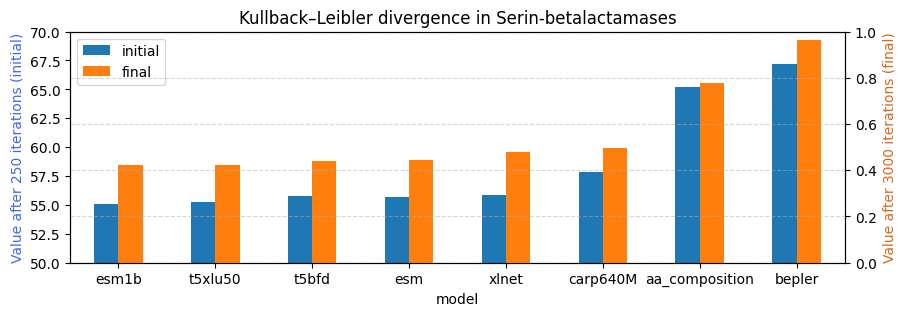

In [28]:
# plot 
df_plm_sbl.plot.bar(figsize=(10,3), x = "model", secondary_y= 'final', mark_right=False, rot= 0)
# gets the current figure and then the axes
ax1, ax2 = plt.gcf().get_axes() 
ax1.set_ylabel('Value after 250 iterations (initial)', color = "royalblue")
ax2.set_ylabel('Value after 3000 iterations (final)', color = "chocolate")
plt.title("Kullback–Leibler divergence in Serin-betalactamases")
plt.grid(alpha = 0.5, linestyle = "--")
ax1.set_ylim([50,70])
ax2.set_ylim([0.0, 1])

## Full dset with esm1b 

In [72]:
df_all = pd.merge(df_annot, df_plm, on = "seq_id", how = "left")
print(len(df_all))

26023


In [79]:
#select data
df_all_sbl = df_all[~df_all.bla_class.str.contains("Class B|VarG|Consensus")]
df_all_mbl = df_all[df_all.bla_class.str.contains("Class B|VarG")]

df_all_cons = df_all[df_all.bla_class.str.contains("Consensus")]
df_all_cons_sbl = df_all_cons[~df_all_cons.protein_name.str.contains("class_b")]
df_all_cons_mbl = df_all_cons[df_all_cons.protein_name.str.contains("class_b")]

# concat data
df_all_sbl = pd.concat([df_all_sbl, df_all_cons_sbl])
df_all_mbl = pd.concat([df_all_mbl, df_all_cons_mbl])

# reset idx
df_all_sbl = df_all_sbl.reset_index(drop=True)
df_all_mbl = df_all_mbl.reset_index(drop=True)

In [82]:
# check data 
print(df_all_sbl.bla_class.unique())
print(df_all_mbl.bla_class.unique())
print(f"Total data points = {len(df_all_sbl)+len(df_all_mbl)}")

['Class A' 'Class C' 'Class D' 'Ancestral' 'Risso cons' 'Consensus']
['Class B' 'VarG' 'Consensus']
Total data points = 26023


In [88]:


def do_tsne_full_dset(df_in, bla_class):
    
    """
    A quick function to do a tSNE given a protein language model and dataset
    """
    
    # set names
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_fulldset_" + bla_class + "_" + model + ".csv"
    
    # compute tsne
    df = df_in
    tsne_options = {"n_components": 2, "perplexity": 400, "n_iter": 1500, "metric": "cosine"}
    proyected_dims = tsne_reduce(df[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"{model}")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)
    
    # save data
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3335 samples in 0.002s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning:

'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.



[t-SNE] Computed neighbors for 3335 samples in 0.681s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3335
[t-SNE] Computed conditional probabilities for sample 2000 / 3335
[t-SNE] Computed conditional probabilities for sample 3000 / 3335
[t-SNE] Computed conditional probabilities for sample 3335 / 3335
[t-SNE] Mean sigma: 0.033308
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.507988
[t-SNE] KL divergence after 1500 iterations: 0.248308
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_fulldset_mbl_esm1b.csv


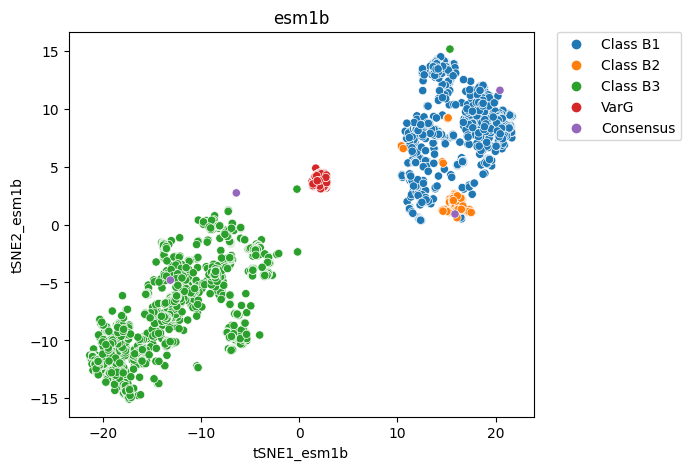

In [89]:
do_tsne_full_dset(df_all_mbl, "mbl")

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning:

'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.



[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 22688 samples in 0.023s...
[t-SNE] Computed neighbors for 22688 samples in 17.943s...
[t-SNE] Computed conditional probabilities for sample 1000 / 22688
[t-SNE] Computed conditional probabilities for sample 2000 / 22688
[t-SNE] Computed conditional probabilities for sample 3000 / 22688
[t-SNE] Computed conditional probabilities for sample 4000 / 22688
[t-SNE] Computed conditional probabilities for sample 5000 / 22688
[t-SNE] Computed conditional probabilities for sample 6000 / 22688
[t-SNE] Computed conditional probabilities for sample 7000 / 22688
[t-SNE] Computed conditional probabilities for sample 8000 / 22688
[t-SNE] Computed conditional probabilities for sample 9000 / 22688
[t-SNE] Computed conditional probabilities for sample 10000 / 22688
[t-SNE] Computed conditional probabilities for sample 11000 / 22688
[t-SNE] Computed conditional probabilities for sample 12000 / 22688
[t-SNE] Computed conditional probabilities for 

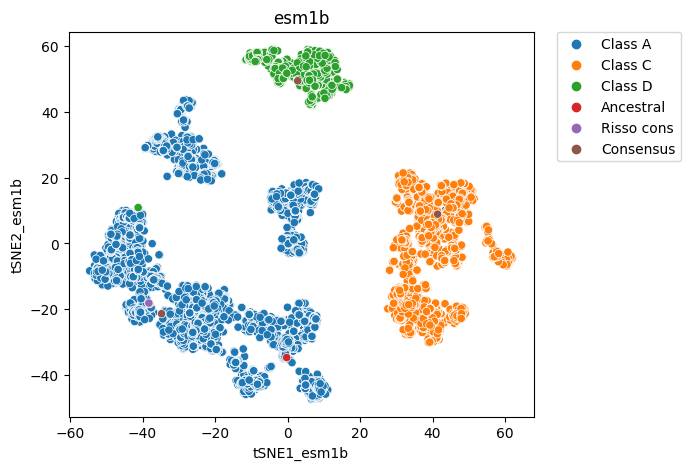

In [90]:
do_tsne_full_dset(df_all_sbl, "sbl")

## only cluster rep at 90

In [118]:
df_all_sbl90 = df_all_sbl[df_all_sbl.is_clust90_rep.str.contains("Yes")]
df_all_sbl90 = df_all_sbl90.reset_index(drop=True)
print(f" number of seqs in SBL clust90 {len(df_all_sbl90)}")

df_all_mbl90 = df_all_mbl[df_all_mbl.is_clust90_rep.str.contains("Yes")]
df_all_mbl90 = df_all_mbl90.reset_index(drop=True)
print(f" number of seqs in MBL clust90 {len(df_all_mbl90)}")

 number of seqs in SBL clust90 5450
 number of seqs in MBL clust90 1280


In [124]:
def do_tsne_clust90(df, bla_class):
    
    """
    A quick function to do a tSNE given a protein language model and dataset
    """
    
    # set names
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_clust90_" + bla_class + "_" + model + ".csv"
    
    # compute tsne
    tsne_options = {"n_components": 2, "perplexity": 400, "n_iter": 1500, "metric": "cosine"}
    proyected_dims = tsne_reduce(df[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"Representative sequences at 90% identitiy | {model}")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)
    
    # save data
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning:

'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.



[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 1280 samples in 0.001s...
[t-SNE] Computed neighbors for 1280 samples in 0.564s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1280
[t-SNE] Computed conditional probabilities for sample 1280 / 1280
[t-SNE] Mean sigma: 0.042020
[t-SNE] KL divergence after 250 iterations with early exaggeration: 43.103603
[t-SNE] KL divergence after 750 iterations: 0.169238
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_clust90_mbl_esm1b.csv


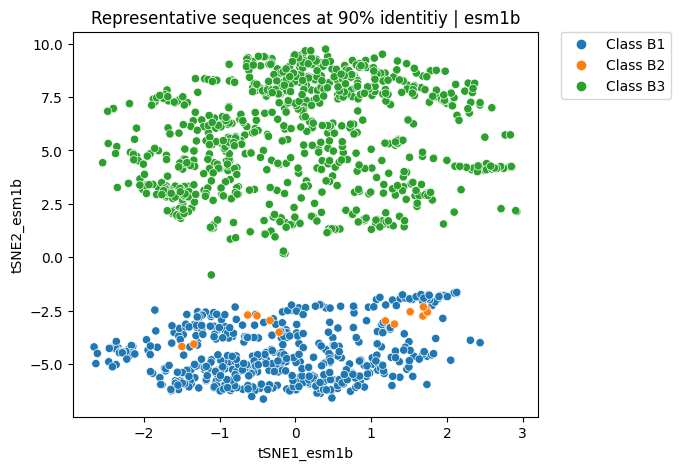

In [125]:
do_tsne_clust90(df_all_mbl90, "mbl")

[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 5450 samples in 0.003s...


/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning:

'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.



[t-SNE] Computed neighbors for 5450 samples in 1.408s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5450
[t-SNE] Computed conditional probabilities for sample 2000 / 5450
[t-SNE] Computed conditional probabilities for sample 3000 / 5450
[t-SNE] Computed conditional probabilities for sample 4000 / 5450
[t-SNE] Computed conditional probabilities for sample 5000 / 5450
[t-SNE] Computed conditional probabilities for sample 5450 / 5450
[t-SNE] Mean sigma: 0.031269
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.971458
[t-SNE] KL divergence after 1500 iterations: 0.357656
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_clust90_sbl_esm1b.csv


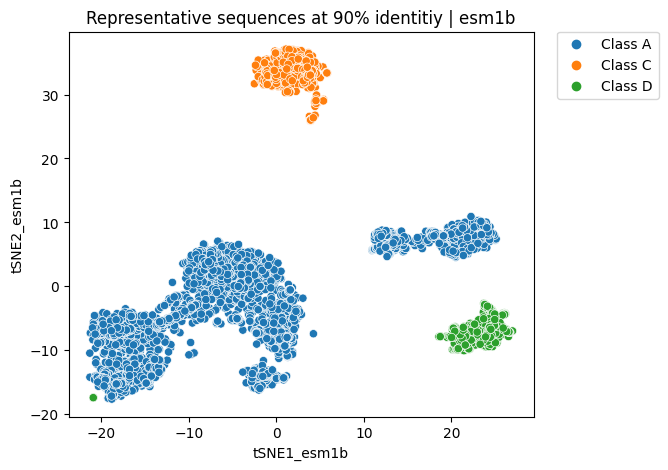

In [126]:
do_tsne_clust90(df_all_sbl90, "sbl")

## rand sample

In [139]:
df_a = df[df['bla_class'] == "Class A"].sample(1000)
df_c = df[df['bla_class'] == "Class C"].sample(1000)
df_d = df[df['bla_class'] == "Class D"].sample(1000)
df_rand_sbl = pd.concat([df_a,df_c,df_d])
df_rand_sbl = df_rand_sbl.reset_index(drop=True)

df_rand_mbl = df[df['bla_class'] == "Class B"].sample(1000)
df_rand_mbl = df_rand_mbl.reset_index(drop=True)

In [136]:
def do_tsne_rand(df_in, bla_class):
    
    """
    A quick function to do a tSNE given a protein language model and dataset
    """
    
    # set names
    model = "esm1b"
    dim1 = "tSNE1_" + model
    dim2 = "tSNE2_" + model
    path = "../results/dim_redo/splitted_classes/tsne/" + "tsne_2d_rand1k_" + bla_class + "_" + model + ".csv"
    
    # compute tsne
    tsne_options = {"n_components": 2, "perplexity": 400, "n_iter": 1500, "metric": "cosine"}
    proyected_dims = tsne_reduce(df_in[model].to_list(), **tsne_options)
    tsne = pd.DataFrame(proyected_dims, columns=[dim1, dim2])
    tsne = pd.concat([tsne, df_in[["bla_subclass", "seq_id"]]], axis=1)
    
    # plot 
    plt.figure(figsize=(6, 5))
    sns.scatterplot(data = tsne, x = dim1, y = dim2, hue = "bla_subclass")
    plt.title(f"1k random sequences per class | {model}")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0)
    
    # save data
    tsne.pop("bla_subclass")
    tsne.to_csv(path, index = False)
    print(f"csv file saved as: {path}")

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning:

'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.



[t-SNE] Computing 999 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.001s...
[t-SNE] Computed neighbors for 1000 samples in 0.217s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 0.046707
[t-SNE] KL divergence after 250 iterations with early exaggeration: 40.360962
[t-SNE] KL divergence after 950 iterations: 0.118555
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_rand1k_mbl_esm1b.csv


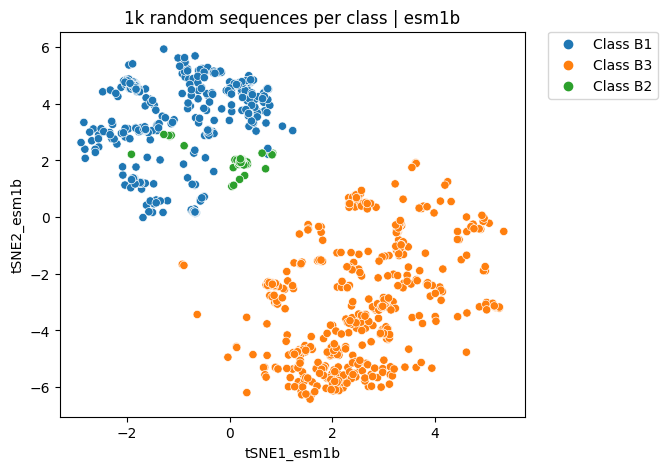

In [141]:
do_tsne_rand(df_rand_mbl, "mbl")

/home/gama/anaconda3/envs/dl/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:691: FutureWarning:

'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.



[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3000 samples in 0.002s...
[t-SNE] Computed neighbors for 3000 samples in 0.793s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3000
[t-SNE] Computed conditional probabilities for sample 2000 / 3000
[t-SNE] Computed conditional probabilities for sample 3000 / 3000
[t-SNE] Mean sigma: 0.035162
[t-SNE] KL divergence after 250 iterations with early exaggeration: 44.431671
[t-SNE] KL divergence after 1500 iterations: 0.170188
csv file saved as: ../results/dim_redo/splitted_classes/tsne/tsne_2d_rand1k_sbl_esm1b.csv


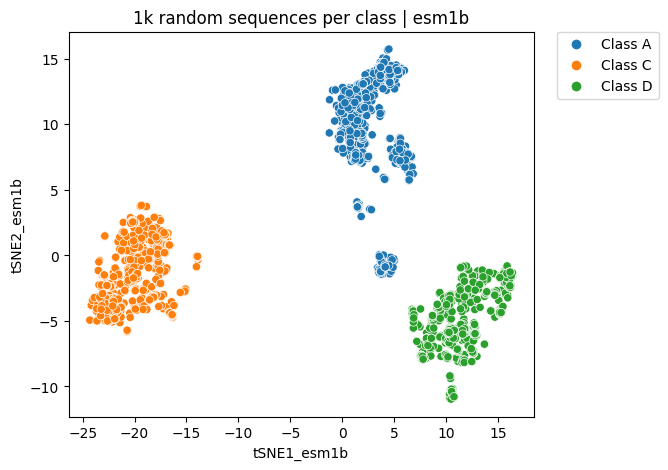

In [142]:
do_tsne_rand(df_rand_sbl, "sbl")

fin